Name: Luca

Surname: Procaccio

Codice persona: 10808417

Matricola: 969019

# Introduction

The dataset comes from a study -Khomtchouk, Bohdan B."Codon usage bias levels predict taxonomic identity and genetic composition." bioRxiv(2020)- where the data has already been divided in train and test set. Data consists of the frequencies of all 64 codons, there are also present classifications according to Kingdom, DNAtype, SpeciesID, Ncodons and SpeciesName.

The goal is classifying different organisms according to the extents in which they use the synonymous codons for
different amino acids. Finally we want to recover AGA and ACA features in the test samples, since they are missing.

We have 11 Kingdoms: bct(bacteria), vrl(virus), pln(plants), vrt(vertebrates), inv(invertebrates), mam(mammals), phg(bacteriophages), rod(rodents), pri(primates), arc(archaea), plm(plasmids).

We have 12 DNA types: 0-genomic, 1-mitochondrial, 2-chloroplast, 3-cyanelle, 4-plastid, 5-nucleomorph, 6-secondary_endosymbiont, 7-chromoplast, 8-leucoplast, 9-NA, 10-proplastid, 11-apicoplast, and 12-kinetoplast.

# REQUEST 1

# Preliminary analysis

In [1]:
import seaborn as sns
import pandas as pd
import numpy as np
import sklearn
import scipy
from sklearn.feature_selection import mutual_info_classif

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors

We read the data and create a pandas Dataframe.

In [2]:
dirty_train = pd.read_csv("train.csv")
dirty_test = pd.read_csv("test.csv")
dirty_train

,Unnamed: 0,Kingdom,DNAtype,SpeciesID,Ncodons,SpeciesName,UUU,UUC,UUA,UUG,...,CGG,AGA,AGG,GAU,GAC,GAA,GAG,UAA,UAG,UGA
0,872,vrl,0,207343,6686,Bovine foamy virus,0.01541,0.00927,0.01720,0.01825,...,0.00643,0.02064,0.01182,0.02812,0.00838,0.03365,0.01974,0.01511,0.00030,0.00030
1,9865,inv,0,7629,10060,Anthocidaris crassispina,0.01213,0.02515,0.00268,0.01352,...,0.00268,0.00915,0.01412,0.03280,0.02555,0.03708,0.05398,0.03330,0.00030,0.00050
2,3190,bct,0,320850,14031,Staphylococcus phage X2,0.02580,0.01618,0.03606,0.01354,...,0.00114,0.01775,0.00499,0.03756,0.02523,0.05388,0.01946,0.02245,0.00121,0.00086
3,3674,bct,0,1397,39839,Bacillus circulans,0.00128,0.02141,0.01225,0.01649,...,0.01177,0.00705,0.00422,0.03316,0.02229,0.03444,0.02370,0.00831,0.00028,0.00063
4,11372,vrt,1,50790,5112,mitochondrion Dascyllus trimaculatus,0.03169,0.01780,0.03893,0.00000,...,0.00000,0.00000,0.00000,0.00020,0.01389,0.02465,0.00352,0.00352,0.00000,0.02465
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10417,7087,pln,0,332388,1791,Pyrus pyrifolia var. culta,0.02289,0.02959,0.00614,0.02680,...,0.00558,0.00893,0.01173,0.03071,0.01954,0.01787,0.02848,0.03127,0.00112,0.00000
10418,2077,vrl,0,374598,68352,Eastern equine encephalitis virus,0.02532,0.01557,0.00878,0.01185,...,0.00477,0.01274,0.01008,0.02070,0.00726,0.02388,0.02233,0.01814,0.00025,0.00038
10419,4497,bct,0,267998,2292,Rhizobium sp. MTP-10005,0.01614,0.02618,0.00131,0.01003,...,0.01702,0.00175,0.00567,0.02487,0.00000,0.02661,0.02618,0.01353,0.00000,0.00349
10420,6491,pln,2,175050,1022,chloroplast Primula chungensis,0.00196,0.01761,0.04501,0.03131,...,0.00391,0.01566,0.00391,0.02348,0.01957,0.03523,0.00978,0.00196,0.00000,0.00196


We remove the "Unnamed" column from the dataset.

In [3]:
train = dirty_train.iloc[:,1:]
test = dirty_test.iloc[:,1:]

The study which the dataset comes from perform a filtering selecting all the features that are in a number greater than 100. I've decided to do the same. In this way we work on 10 kingdoms instead of 11 (plasmid is removed) and 3 DNA types ( 0-genomic, 1-mitochondrial, 2-chloroplast). See data visualization for details.

In [4]:
train = train.groupby("Kingdom").filter(lambda x: len(x) > 100)
train = train.groupby("DNAtype").filter(lambda x: len(x) > 100)

We see that in the test set there are still present plasmid(plm) and dna types(3-12), they have to be removed.

In [5]:
test["Kingdom"].unique()

array(['bct', 'inv', 'pln', 'vrl', 'mam', 'arc', 'phg', 'vrt', 'rod',
       'pri', 'plm'], dtype=object)

In [6]:
test["DNAtype"].unique()

array([ 0,  2,  1,  4,  5, 11], dtype=int64)

In [7]:
test = test[test.Kingdom != "plm"]
test = test[test.DNAtype != 4]
test = test[test.DNAtype != 5]
test = test[test.DNAtype != 11]

Since we have to deal with several samples, some procedures are very slow to run. For this reason I've decided to work with a subset of the training data. We use this code in order to keep the original proportions between groups.

In [8]:
train = train.groupby("Kingdom").apply(lambda x: x.sample(frac=0.7, random_state = np.random.seed(0)))

We create a subset with only the frequencies of the codons. This will be useful for many analyses.

In [9]:
train_codons = train.drop(["Kingdom","DNAtype","SpeciesID","Ncodons","SpeciesName"],axis=1)
test_codons = test.drop(["Kingdom","DNAtype","SpeciesID","Ncodons","SpeciesName"],axis=1)

# Data visualization

As first thing, we plot the number of features for each kingdom. We see that there are only 10 kingdoms, since plasmids have been removed previously.

<AxesSubplot:xlabel='Kingdom', ylabel='count'>

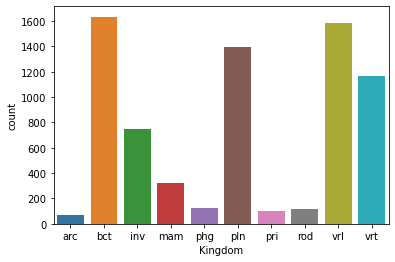

In [10]:
sns.countplot(x = "Kingdom", data = train)

We count the number of features, they are all greater than 100.

In [11]:
train["Kingdom"].value_counts()

bct    1634
vrl    1586
pln    1394
vrt    1163
inv     747
mam     321
phg     123
rod     120
pri     101
arc      71
Name: Kingdom, dtype: int64

We do the same with DNAtype, now we have only 3 types.

<AxesSubplot:xlabel='DNAtype', ylabel='count'>

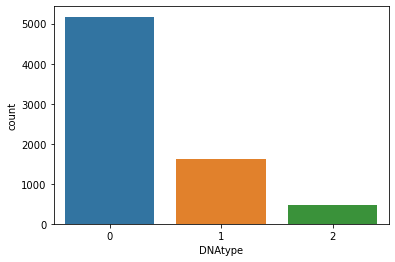

In [15]:
sns.countplot(x = "DNAtype", data = train)

In [16]:
train["DNAtype"].value_counts()

0    5173
1    1614
2     473
Name: DNAtype, dtype: int64

Now we use a violinplot to plot the distribution of frequencies for each codon. We can notice some differences in the frequencies.

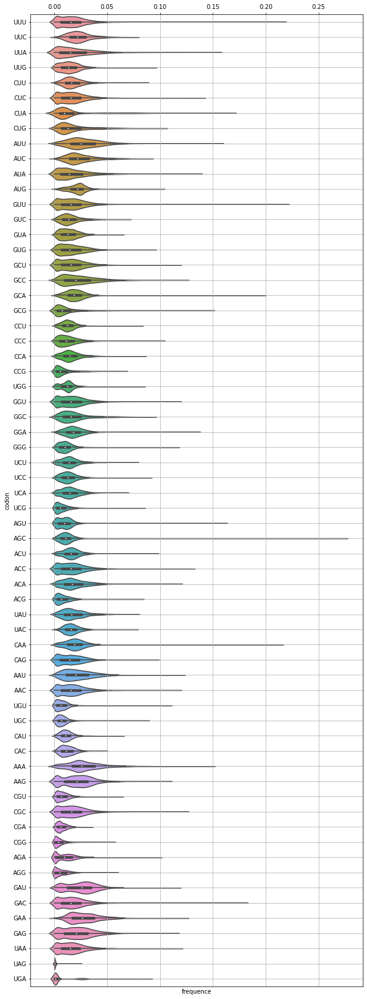

In [17]:
fig=plt.figure(figsize=(10,30))
a=sns.violinplot(data = train_codons ,orient="h",scale="count")
a.set(xlabel='frequence', ylabel='codon')
a.xaxis.set_ticks_position('top')
plt.grid()

We use a heatmap to detect correlation between codon frequencies. 

<AxesSubplot:>

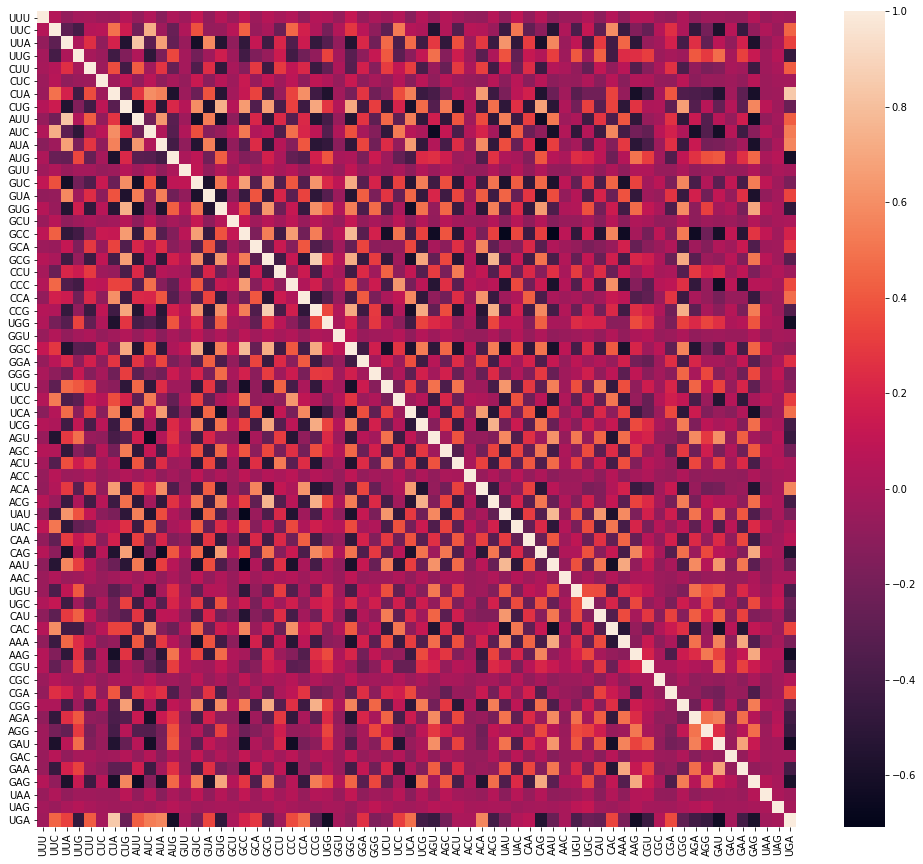

In [18]:
corr_1 = train_codons.corr()
fig = plt.figure(figsize= (17,15))
sns.heatmap(corr_1)

We notice that there are some positive and negative correlations. Due to this fact, we are in the situation where two or more predictor variables are closely related to one another: we have collinearity. The presence of collinearity gives problems in regression, since it can be difficult to separate out the individual effect of collinear variables on the response.

To determine which features are more correlated with target classes, we quantify the relationship between a categorical and a numerical variable. We use the mutual information index from scikit-learn package.

We've decided to extract the 5 most informative codons for each kingdom. Then we do the same with DNAtype.

In [19]:
# extract the name of each kingdom
k = np.unique(train["Kingdom"])
k

array(['arc', 'bct', 'inv', 'mam', 'phg', 'pln', 'pri', 'rod', 'vrl',
       'vrt'], dtype=object)

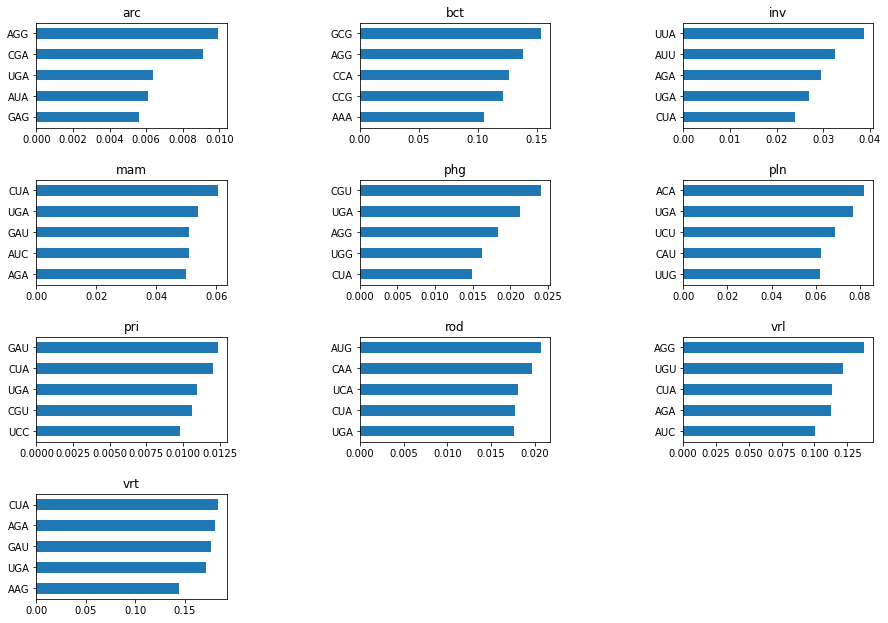

In [20]:
# create the dataframe that will have tue mutual information for each codon in each kingdom
mi_pd = pd.DataFrame(columns = train_codons.columns)

# define the parameters of the plot
fig = plt.figure(figsize = (15,4))
plt.subplots_adjust(top = 5, bottom = 3)
fig.subplots_adjust(wspace=0.7,hspace=0.5)
i = 1

for c in k:
    # compute the mutual information, append it to mi_pd and select the 5 codons with the highest score  
    mi = mutual_info_classif(train_codons, train["Kingdom"] == c)
    mi = pd.Series(mi, index = train_codons.columns, name = c)
    mi_pd = mi_pd.append(mi)
    mi_top5 = mi.nlargest(n=5).dropna().sort_values(ascending = False)
    
    # plot the top 5 codons for each kingdom
    sub = fig.add_subplot(4,3,i)
    i += 1
    mi_top5.plot.barh()
    sub.invert_yaxis()
    plt.title(c)
    
plt.show()

In [21]:
# extract the name of each DNA type
d = np.unique(train["DNAtype"])
d

array([0, 1, 2], dtype=int64)

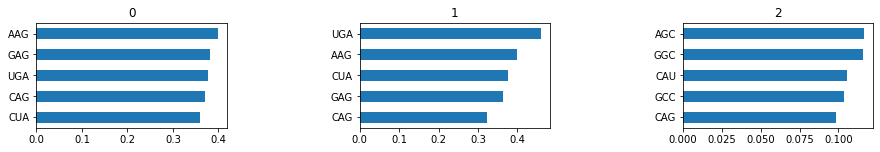

In [22]:
# create the dataframe that will have tue mutual information for each codon in each kingdom
mi_pd = pd.DataFrame(columns = train_codons.columns)

# define the parameters of the plot
fig = plt.figure(figsize = (15,4))
plt.subplots_adjust(top = 5, bottom = 3)
fig.subplots_adjust(wspace=0.7,hspace=0.5)
i = 1

for c in d:
    # compute the mutual information, append it to mi_pd and select the 5 codons with the highest score  
    mi = mutual_info_classif(train_codons, train["DNAtype"] == c)
    mi = pd.Series(mi, index = train_codons.columns, name = c)
    mi_pd = mi_pd.append(mi)
    mi_top5 = mi.nlargest(n=5).dropna().sort_values(ascending = False)
    
    # plot the top 5 codons for each kingdom
    sub = fig.add_subplot(4,3,i)
    i += 1
    mi_top5.plot.barh()
    sub.invert_yaxis()
    plt.title(c)
    
plt.show()

# Clustering

Usually clustering belongs to the unsupervised learning methods, hence the data used as input do not have a label and they are clustered according to their similarities. In this case we know the labels, so using this information along with some clustering evalutation metrics we will be able to assess the goodness of a clustering algorithm.

Since we are interested in both Kingdom and DNAtype classes we have to repeat the analysis twice, we start from Kingdom.

In [12]:
from sklearn.decomposition import PCA
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering, KMeans, DBSCAN
from sklearn.metrics import pairwise_distances
from sklearn.preprocessing import normalize
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import silhouette_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler

## Kingdom

### Data visualization - Dimensionality reduction

We want to have a first idea on how the samples are organized visualizing their distribution in the space. Since we can only visualize 3 dimensions, we have to reduce the number of features using PCA.

First we want two create the data points by extracting only the codon frequencies from the dataset and create an array.

In [24]:
X = np.array(train.drop(["Kingdom","DNAtype","SpeciesID","Ncodons","SpeciesName"],axis=1))
X

array([[0.00546, 0.02297, 0.04054, ..., 0.00158, 0.00046, 0.00165],
       [0.01753, 0.01629, 0.02436, ..., 0.02141, 0.00047, 0.0031 ],
       [0.     , 0.03   , 0.00471, ..., 0.03118, 0.     , 0.00059],
       ...,
       [0.02818, 0.03481, 0.0105 , ..., 0.0011 , 0.     , 0.01713],
       [0.00175, 0.02413, 0.00671, ..., 0.01519, 0.00068, 0.00124],
       [0.00219, 0.0278 , 0.0256 , ..., 0.03438, 0.00146, 0.02304]])

Kingdom is a categorical variable, the algorithm work only with numerical variables, so we have to transform each kingdom into an integer. So we import LabelEncoder from sklearn.preprocessing. 

In [25]:
from sklearn.preprocessing import LabelEncoder

We encode each kingdom in the dataset into an integer, kingdoms with the same name will be associated to the same integer.

In [26]:
le = LabelEncoder()
kingdom_encoded = le.fit_transform(train["Kingdom"])

print(kingdom_encoded)

[0 0 0 ... 9 9 9]


In [27]:
# select unique integers
k_encoded = np.unique(kingdom_encoded)

To show more easily the association between kingdom and integer we have created a dataframe.

In [28]:
info = {"Kingdom": k,
       "Encoded": k_encoded
        }

df = pd.DataFrame(info)
print(df)

  Kingdom  Encoded
0     arc        0
1     bct        1
2     inv        2
3     mam        3
4     phg        4
5     pln        5
6     pri        6
7     rod        7
8     vrl        8
9     vrt        9


Now we define PCA and transfrom our datapoints.

In [29]:
# Define PCA with 3 components, this will transform 
pca = PCA(n_components=3)

# Reduce features dimensionality, just for visualization purposes
X_prj = pca.fit_transform(X)
X_prj.shape

(7260, 3)

In [30]:
def plot3d(X, labels):
    # Set matplotlib to generate static images
    # %matplotlib notebook
    # Set matplotlib as interactive
    # %matplotlib inline
    # This import is required to set up the 3D environment
    from mpl_toolkits.mplot3d import Axes3D
    
    pca = PCA(n_components=3)
    
    # Reduce features dimensionality, just for visualization
    # purposes
    X = pca.fit_transform(X)
    
    unique_labels = np.unique(labels)
    # Convert negative values (outliers) into positive
    labels = labels.copy()
    labels += np.abs(unique_labels.min())
    nlabels = len(unique_labels)
    fig = plt.figure(figsize=(15,10))
    ax = fig.add_subplot(111, projection='3d')
    
    # Define color mappings
    col = ('tab10' if nlabels <= 10 else 
          ('tab20' if nlabels <= 20 else
           'hsv'))
    cmap = plt.cm.get_cmap(col)
    smap = cm.ScalarMappable(
              norm=mcolors.Normalize(unique_labels.min(), unique_labels.max()+1), 
              cmap=cmap)
    # Plot the 3d coordinates (similar to standard scatter plots, we just
    # need to provide an additional z coordinate!)
    ax.scatter(xs=X_prj[:, 0], ys=X_prj[:, 1], zs=X_prj[:, 2], c=labels, cmap=cmap)
    # Plot a color bar on the right
    plt.colorbar(mappable=smap, label='digit label', ticks=range(nlabels))

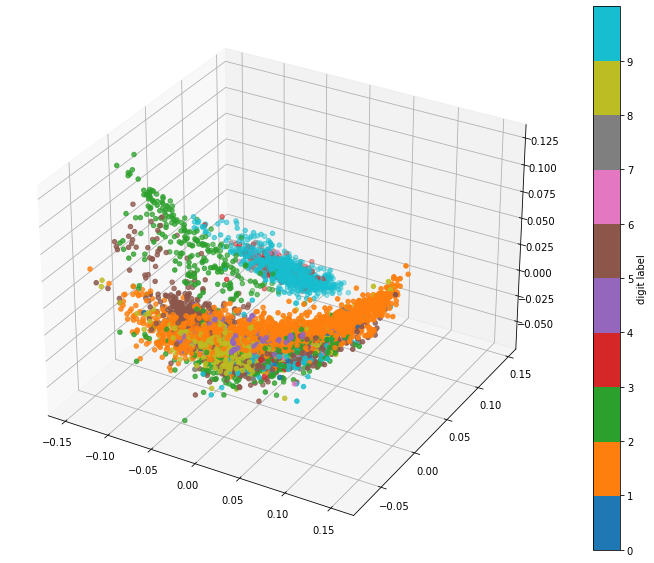

In [31]:
plot3d(X, labels=kingdom_encoded)

Looking at the graph we don't see a very good clusterization and only few clusters seem clearly separated.
Probably the clustering algortihms of the next parts will not perform well for kingdom.

# Agglomerative hierarchical clustering

Agglomerative hierarchical clustering is a technique that works in a bottom-up way. In fact, according to a distance metric, this algorithm merges clusters iteratively until all groups are part of a unique cluster. The hierarchy is represented graphically by a dendrogram.

In distance-based clustering two parameters affect the result: the metric used to compute the distances between data points and the linkage, that is how the clusters are merged together.

In [32]:
def plot_dendrogram(Z=None, model=None, X=None, **kwargs):
    annotate_above = kwargs.pop('annotate_above', 0)

    # Reconstruct the linakge matrix if the standard model API was used
    if Z is None:
        if hasattr(model, 'distances_') and model.distances_ is not None:
            # create the counts of samples under each node
            counts = np.zeros(model.children_.shape[0])
            n_samples = len(model.labels_)
            for i, merge in enumerate(model.children_):
                current_count = 0
                for child_idx in merge:
                    if child_idx < n_samples:
                        current_count += 1  # leaf node
                    else:
                        current_count += counts[child_idx - n_samples]
                counts[i] = current_count

            Z = np.column_stack([model.children_, model.distances_,
                                              counts]).astype(float)
        else:
            Z = linkage(X, method=model.linkage, metric=model.affinity)
    
    if 'n_clusters' in kwargs:
        n_clusters = kwargs.pop('n_clusters')
        # Set the cut point just above the last but 'n_clusters' merge
        kwargs['color_threshold'] = Z[-n_clusters, 2] + 1e-6
    
    fig = plt.figure(figsize=(20,10))
    ax = fig.add_subplot(111)
    # Plot the corresponding dendrogram
    ddata = dendrogram(Z, ax=ax, **kwargs) 
    
    # Annotate nodes in the dendrogram
    for i, d, c in zip(ddata['icoord'], ddata['dcoord'], ddata['color_list']):
        x = 0.5 * sum(i[1:3])
        y = d[1]
        nid = np.where(Z[:,2] == y)[0][0]
        if y > annotate_above:
            plt.plot(x, y, 'o', c=c)
            plt.annotate(str(nid-Z.shape[0]), (x, y), xytext=(0, -5),
                         textcoords='offset points',
                         va='top', ha='center')
    if kwargs['color_threshold']:
        plt.axhline(y=kwargs['color_threshold'], c='k')
    
    return fig, ax

# Linkage methods

There are 5 types of linkage methods, each with its characteristics, the effectiveness depends on the data:

1. Single linkage: minimizes distance between closest observations of pairs of clusters.
2. Average linkage: minimizes the average of distances between observations of pairs of clusters.
3. Maximum linkage: minimizes the maximum distance between observations of pairs of clusters.
4. Centroid linkage: minimizes the distance between centroids of pairs of clusters.
5. Ward: linkage minimizes the total within-cluster variance.

Here we test all these different methods, we use euclidean distance.

In [33]:
methods = ['single', 'average', 'complete', 'centroid', 'ward']

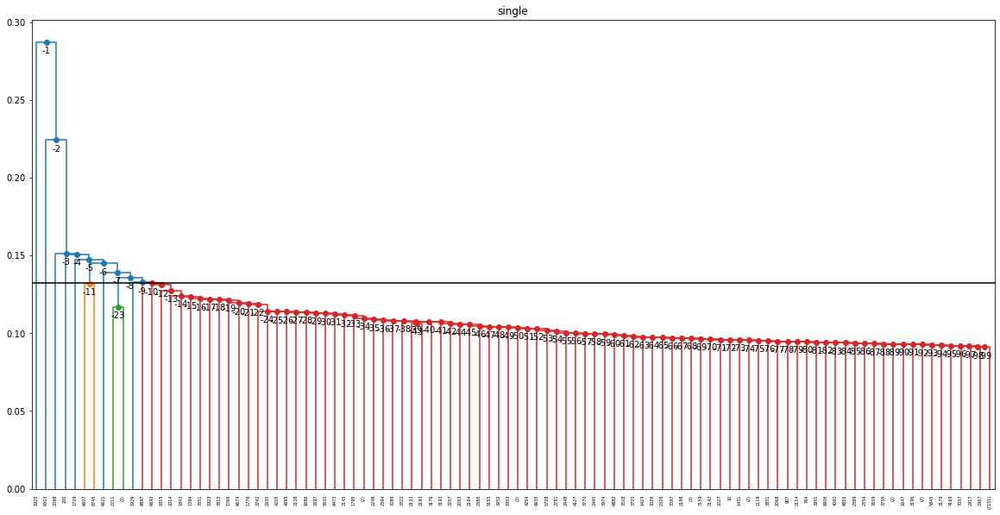

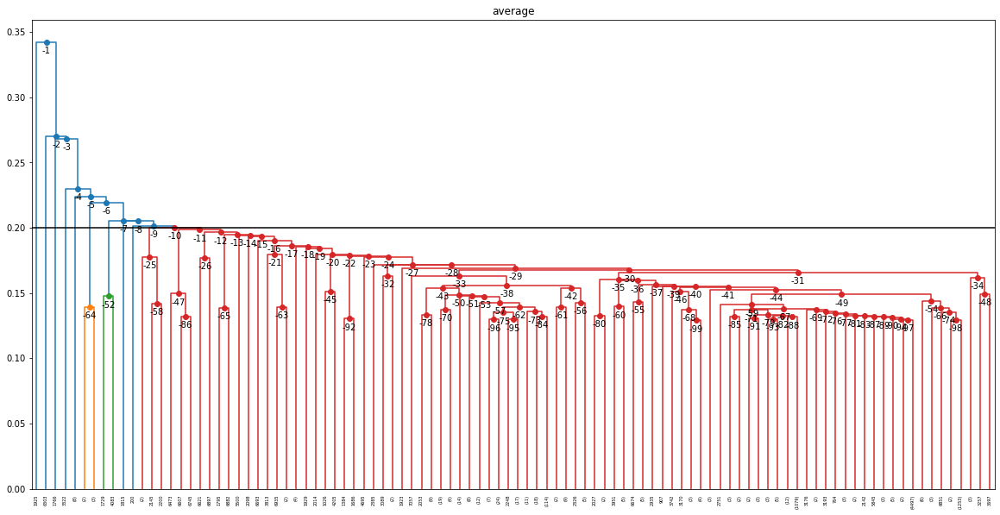

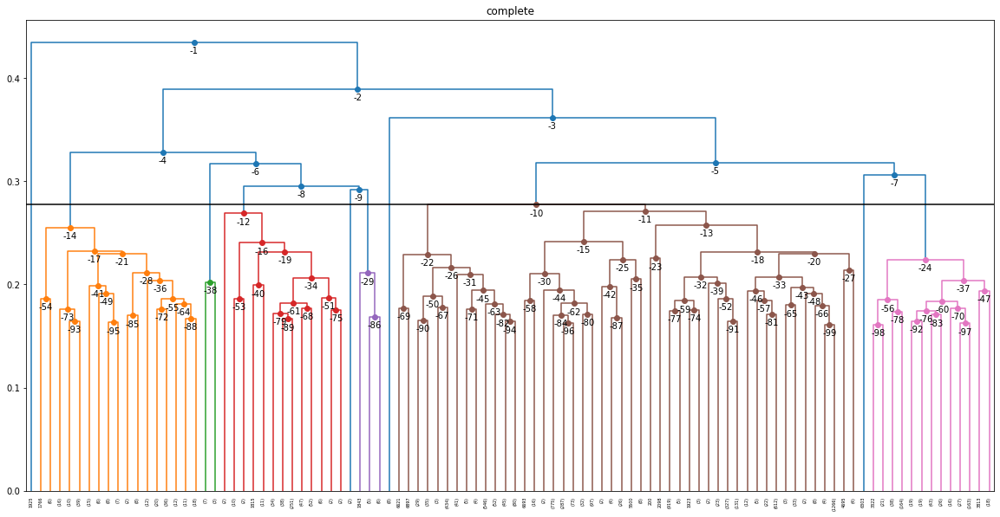

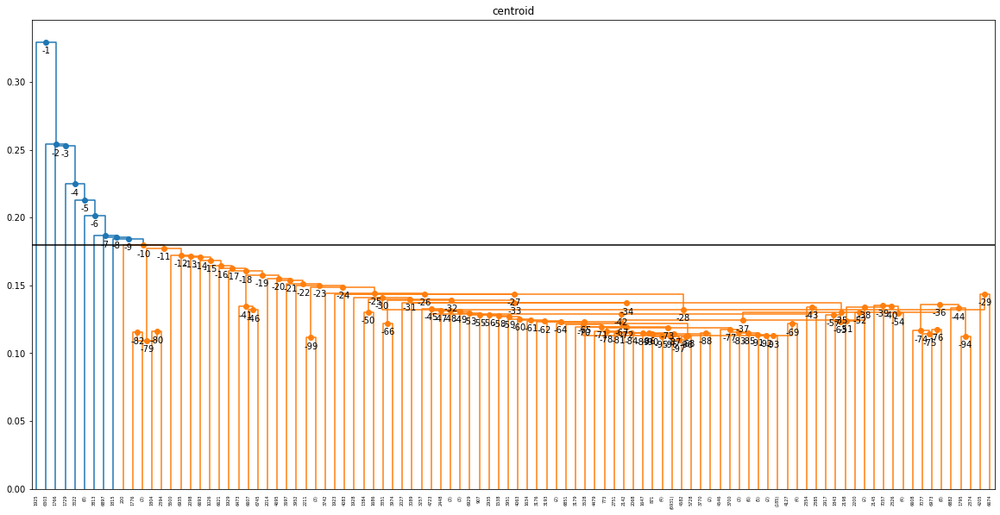

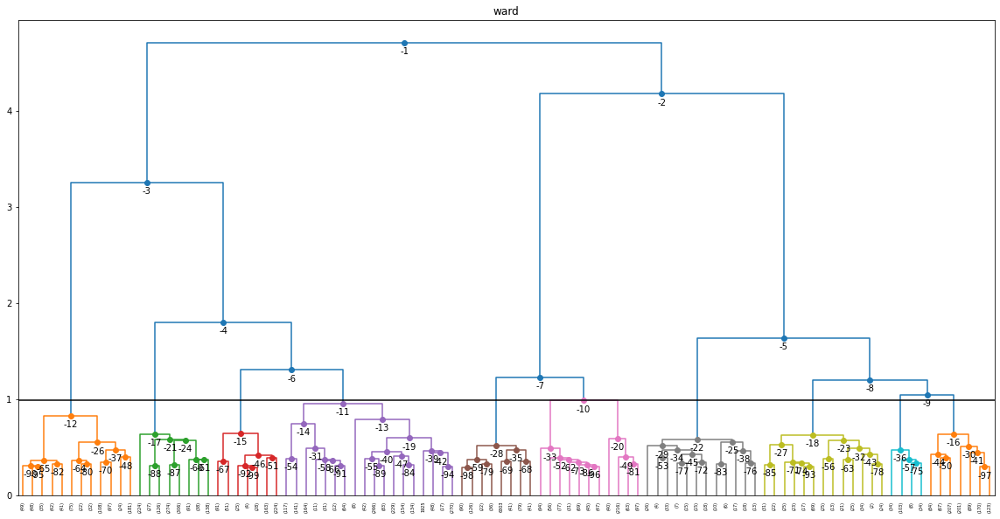

In [34]:
for method in methods:
    Z = linkage(X, metric='euclidean', method=method)
    fig, ax = plot_dendrogram(Z=Z, X=X, truncate_mode='lastp', 
                              p=100, n_clusters=10)
    ax.set_title(method)

In our case the best seems to be the Ward linkage, since the only distance-metric available for this type of linkage is the Euclidean, we will use it.

# Agglomerative clustering algorithm

Now we use the standard scikit-learn API, since it provides the fit() and predict() methods.

(<Figure size 1440x720 with 1 Axes>, <AxesSubplot:>)

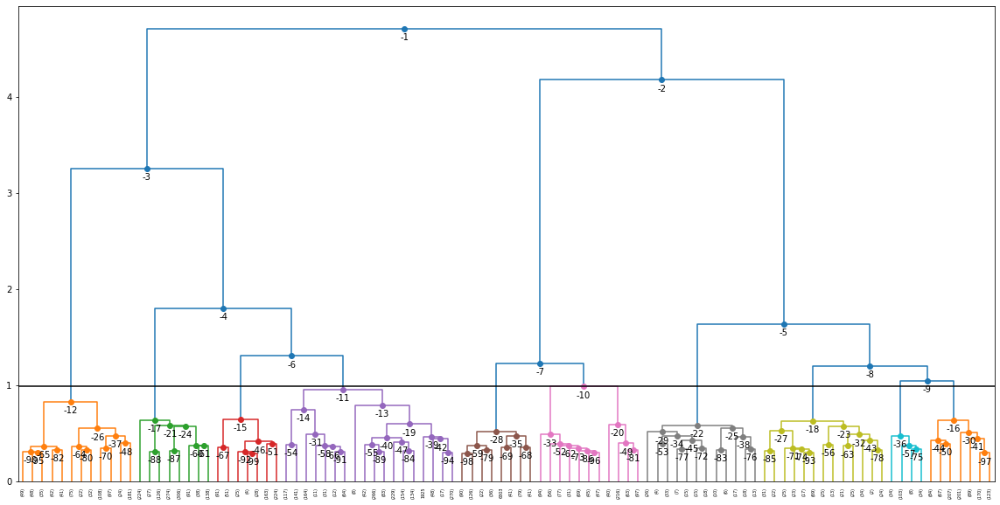

In [35]:
distance_threshold=None
n_clusters=10

model = AgglomerativeClustering(n_clusters=n_clusters, 
                                distance_threshold=distance_threshold, 
                                affinity='euclidean', linkage='ward')

y_predict = model.fit_predict(X)

plot_dendrogram(model=model, X=X, truncate_mode='lastp', p=100, 
                n_clusters=n_clusters, 
                color_threshold=distance_threshold)

### Clustering metrics

We define some functions that we will use to assess and quantify the goodness of fit.

In [36]:
def incidence_mat(y_pred):
    npoints = y_pred.shape[0]
    mat = np.zeros([npoints, npoints])
    # Retrieve how many different cluster ids there are
    clusters = np.unique(y_pred)
    nclusters = clusters.shape[0]
    
    for i in range(nclusters):
        sample_idx = np.where(y_pred == i)
        # Compute combinations of these indices
        idx = np.meshgrid(sample_idx, sample_idx)
        mat[idx[0].reshape(-1), idx[1].reshape(-1)] = 1
        
    return mat

def similarity_mat(X, metric):
    dist_mat = pairwise_distances(X, metric=metric)
    min_dist, max_dist = dist_mat.min(), dist_mat.max()
    
    # Normalize distances in [0, 1] and compute the similarity
    sim_mat = 1 - (dist_mat - min_dist) / (max_dist - min_dist)
    return sim_mat

def correlation(X, y_pred, metric):
    inc = incidence_mat(y_pred)
    sim = similarity_mat(X, metric)
    
    # Note: we can eventually remove duplicate values
    # only the upper/lower triangular matrix
    # triuidx = np.triu_indices(y_pred.shape[0], k=1)
    # inc = inc[triuidx]
    # sim = sim[triuidx]
    
    inc = normalize(inc.reshape(1, -1))
    sim = normalize(sim.reshape(1, -1))
    corr = (inc @ sim.T)
    return corr[0,0]

def sorted_sim(sim, y_pred):
    idx_sorted = np.argsort(y_pred)
    # Sort the rows
    sim = sim[idx_sorted]
    # Sort the columns
    sim = sim[:, idx_sorted]
    
    return sim

def plot_sorted_mat(sim, y_pred):
    sim = sorted_sim(sim, y_pred)
    
    fig, ax = plt.subplots(figsize=(40,30))  
    ax = sns.heatmap(sim, ax=ax)
    # Remove ruler (ticks)
    ax.set_yticks([]) 
    ax.set_xticks([])
    
def get_Ncounts(y_predict, y_true, k, j=None):
    N = y_true.shape[0]
    Nk_mask = y_predict == k
    Nk = Nk_mask.sum()
    Nj, Nkj = None, None
    if j is not None:
        Nj_mask = y_true == j
        Nj = Nj_mask.sum()
        Nkj = np.logical_and(Nj_mask, Nk_mask).sum()
    return N, Nk, Nj, Nkj

def precision(y_predict, y_true, k, j):
    N, Nk, Nj, Nkj = get_Ncounts(y_predict, y_true, k, j)
    return Nkj / (Nk + 1e-8)
    
def recall(y_predict, y_true, k, j):
    N, Nk, Nj, Nkj = get_Ncounts(y_predict, y_true, k, j)
    return Nkj / (Nj + 1e-8)

def F(y_predict, y_true, k, j):
    p = precision(y_predict, y_true, k, j)
    r = recall(y_predict, y_true, k, j)
    return (2*p*r) / (p+r)

def purity(y_predict, y_true, k):
    cls = np.unique(y_true)
    prec = [precision(y_predict, y_true, k, j) for j in cls]
    return max(prec)

def tot_purity(y_predict, y_true):
    N = y_true.shape[0]
    nc = len(np.unique(y_true))
    p = 0
    for k in range(nc):
        N, Nk, _, _ = get_Ncounts(y_predict, y_true, k)
        pk = purity(y_predict, y_true, k)
        p += (Nk / N) * pk
    return p

We plot the sorted similarity matrix, this tool is helpful to assess the quality of clustering. If the clustering is good we should see the blocks with the highest similarity on the diagonal. 

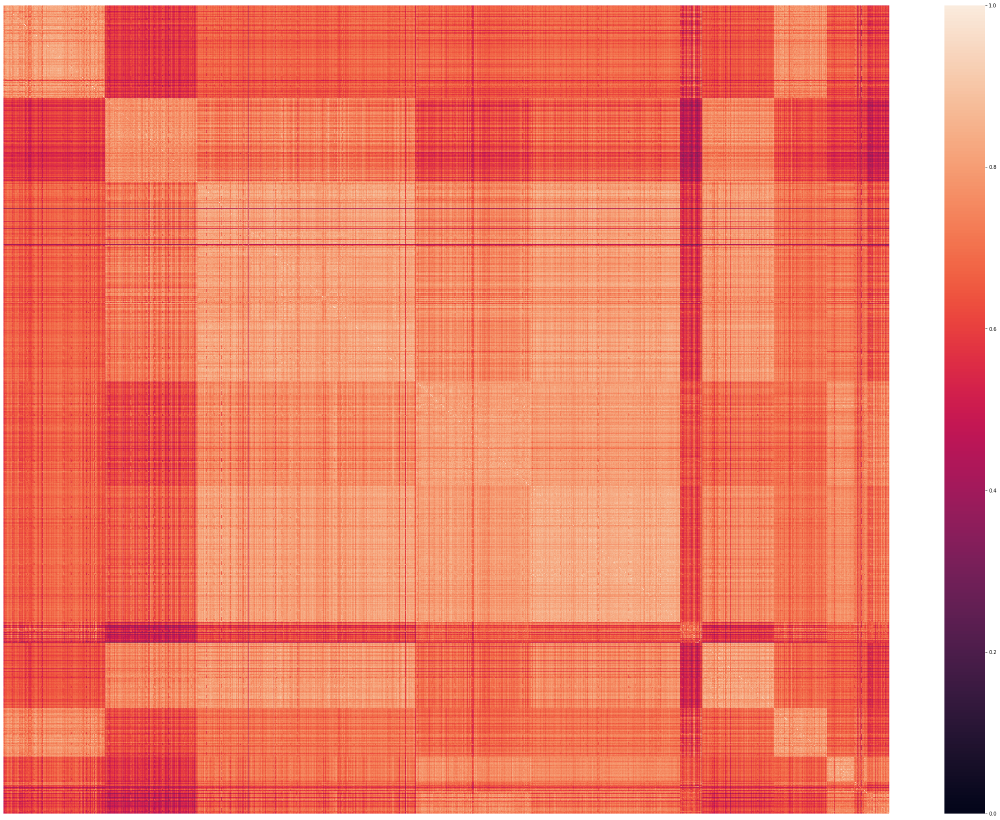

In [37]:
sim = similarity_mat(X, 'euclidean')
plot_sorted_mat(sim, y_predict)

The result is far from good, this is an indicator that the clustering algorithm did not perform well.

Now we compute purity, this metric explain whether features of the same kingdom are in the same cluster. The result will be in a range from 0 to 1.

In [38]:
print("Hierarchical clustering purity:", tot_purity(y_predict, kingdom_encoded))

Hierarchical clustering purity: 0.537741046823624


As we can see the purity is not high.

# K-means

In k-means algorithm we have to state the number of clusters that we want, then the data points are assigned to the closest centroid, the process is repeated until the clusters don't change. There are different types of initialization for the centroids.

Kmeans purity 0.5750688705145414


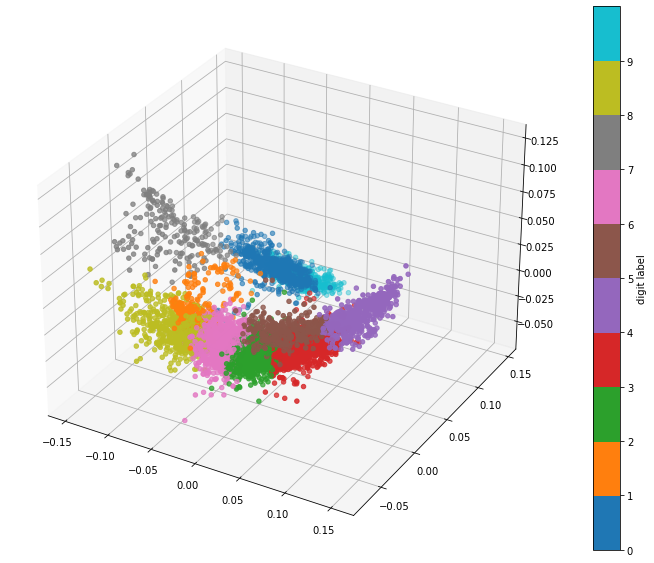

In [39]:
model = KMeans(n_clusters=10, init='random', random_state=0)             
y_predict = model.fit_predict(X)
print("Kmeans purity", tot_purity(y_predict, kingdom_encoded))

plot3d(X, labels=y_predict)

Also in this case the purity is not very high and the algorithm does not perform very well.

## Initialization

Now we try different initialization too see if the result of the clustering improves.
We use random initialzation (the same used in the previous step), non-random initialization and hierarchical clustering + k-means.

Running hierchical clustering on a smaller set of points, we search for K cluster, and then initialize KMeans as the centroids identified by hierarchical clustering.

In kmeans++, we compute each time the minimum distance $D(x)$ between a point x and one of the selected centroids. Then we randomly select the next one with probability inversally proportional to $D(x)^2$. In other words, we sample points far away with higher probability w.r.t. those close to already selected points.

In [40]:
# Random
model = KMeans(n_clusters=10, init='random', random_state=0)             
print("Random Kmeans purity", tot_purity(model.fit_predict(X), kingdom_encoded))

# K-Means++
model = KMeans(n_clusters=10, init='k-means++', random_state=0)             
print("Kmeans++ purity", tot_purity(model.fit_predict(X), kingdom_encoded))

# Hierarchical
hmodel = AgglomerativeClustering(n_clusters=10, 
                                distance_threshold=distance_threshold, 
                                affinity='euclidean', linkage='ward')
y_predict = hmodel.fit_predict(X)
centroids = np.stack([X[y_predict == k].mean(0) for k in range(10)])
model = KMeans(n_clusters=10, init=centroids, n_init=1, random_state=0)             
print("Hierarchical+Kmeans purity", tot_purity(model.fit_predict(X), kingdom_encoded))

Random Kmeans purity 0.5750688705145414
Kmeans++ purity 0.5750688705145376
Hierarchical+Kmeans purity 0.546143250680353


Kmeans++ is the one that performs better, however is still not satisfying.

We plot the sorted similarity matrix.

K-means++


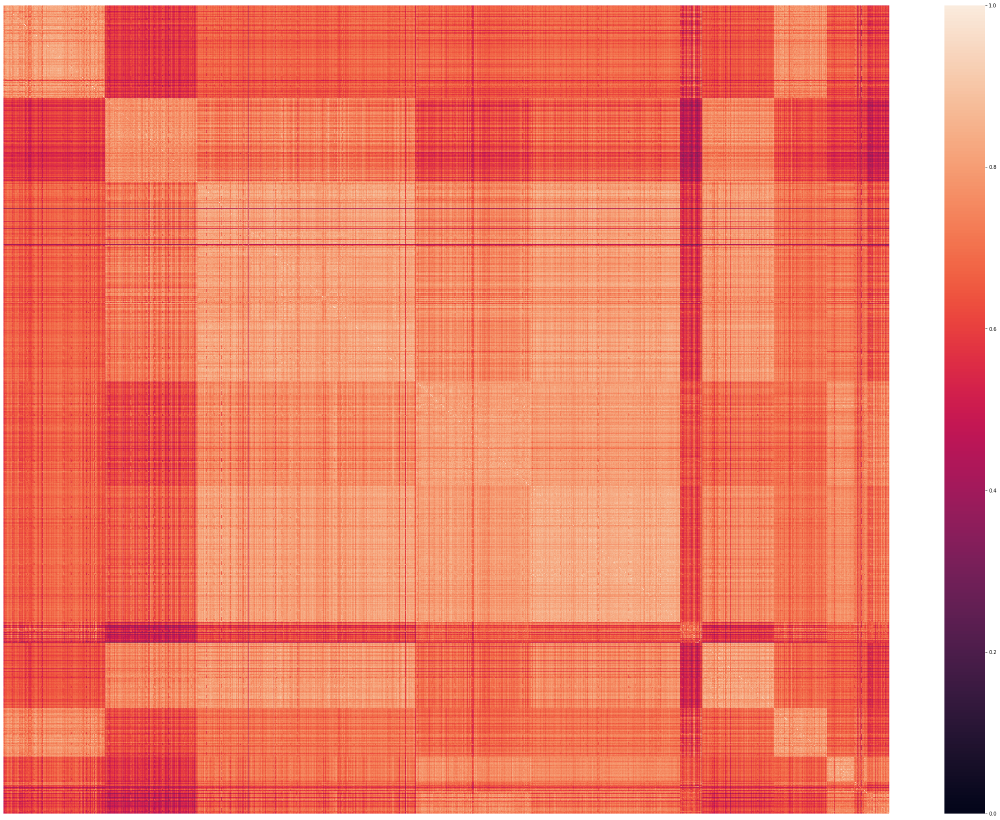

In [41]:
print("K-means++")
plot_sorted_mat(sim,y_predict)

We notice that also kmeans performs poorly.

### Elbow analysis for agglomerative clustering

We define other meterics that we can use to assess the goodness of the clustering. The within sum of squares(wss), which measures the intra-cluster similarity, the between sum of squares(bss) which measures the inter-cluster similarity and the silhouette coefficient which summarizes these two indexes. 
These indexes that we are defining should be used to evaluate the performance of a clustering algorithm with different number of selected clusters.

In [42]:
def wss(X, y_pred, metric):
    ncluster = np.unique(y_pred).shape[0]
    err = 0
    for k in range(ncluster):
        # All the points of this cluster
        X_k = X[y_pred == k]
        # Distances of all points within the cluster
        dist_mat = pairwise_distances(X_k, metric=metric)
        # Select the lower triangular part of the matrix
        triu_idx = np.tril_indices(dist_mat.shape[0], k=1)
        err += (dist_mat[triu_idx] ** 2).sum()
    
    return err

def bss(X, y_pred, metric):
    ncluster = np.unique(y_pred).shape[0]
    # Sort the distance matrix (as we did for the simiarity)
    dist_mat = pairwise_distances(X, metric=metric) ** 2
    dist_mat = sorted_sim(dist_mat, y_predict)
    y_sort = np.sort(y_pred)
    
    err = 0
    for k in range(ncluster):
        kidx = np.where(y_sort == k)[0]
        start, end = kidx[0], kidx[-1]
        err += dist_mat[start:end, end+1:].sum()
    
    return err

In [43]:
def wss(X, y_pred, metric):
    inc = incidence_mat(y_pred)
    
    dist_mat = pairwise_distances(X, metric=metric)
    dist_mat = dist_mat * inc
    triu_idx = np.triu_indices(X.shape[0], k=1)
    
    return (dist_mat[triu_idx] ** 2).sum()

def bss(X, y_pred, metric):
    inc = incidence_mat(y_pred)
    not_inc = 1 - inc
    
    dist_mat = pairwise_distances(X, metric=metric)
    dist_mat = dist_mat * not_inc
    triu_idx = np.triu_indices(X.shape[0], k=1)
    
    return (dist_mat[triu_idx] ** 2).sum()

In [44]:
print("WSS", wss(X, y_predict, 'euclidean'))
print("BSS", bss(X, y_predict, 'euclidean'))

WSS 31001.208096820166
BSS 428865.07299001975


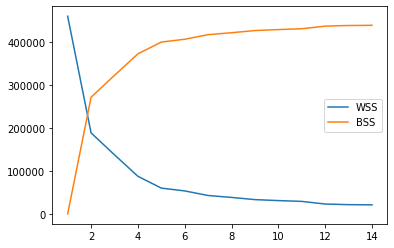

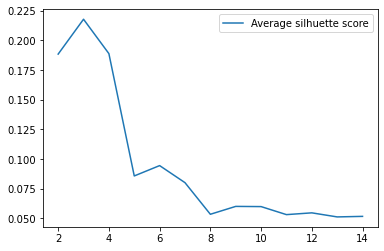

In [45]:
wss_list, bss_list, sil_list = [], [], []
clus_list = list(range(1, 15))

for nc in clus_list:
    model = AgglomerativeClustering(n_clusters=nc,
                                    affinity='euclidean', 
                                    linkage='ward')

    y_predict = model.fit_predict(X)
    
    wss_list.append(wss(X, y_predict, 'euclidean'))
    bss_list.append(bss(X, y_predict, 'euclidean'))
    if nc > 1:
        sil_list.append(silhouette_score(X, y_predict, metric='euclidean'))
    
plt.plot(clus_list, wss_list, label='WSS')
plt.plot(clus_list, bss_list, label='BSS')
plt.legend()
plt.show()

plt.plot(clus_list[1:], sil_list, label='Average silhuette score')
plt.legend()

We see that wss decrease with an increase in the number of clusters and bss do the opposite. Here is significant the graph of silhouette coefficient, which indicates that the best number of clusters that should be chosen would be 3.

### Elbow analysis for kmeans++ clustering

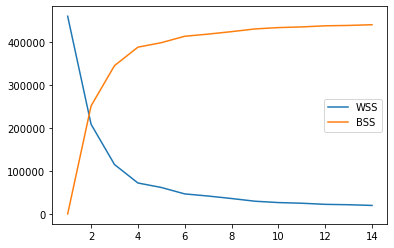

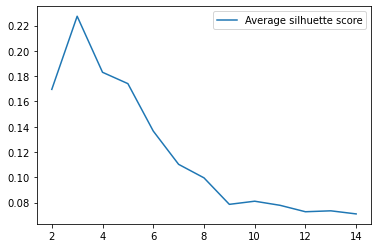

In [46]:
wss_list, bss_list, sil_list = [], [], []
clus_list = list(range(1, 15))

for nc in clus_list:
    model = KMeans(n_clusters = nc, init='k-means++', random_state=0) 

    y_predict = model.fit_predict(X)
    
    wss_list.append(wss(X, y_predict, 'euclidean'))
    bss_list.append(bss(X, y_predict, 'euclidean'))
    if nc > 1:
        sil_list.append(silhouette_score(X, y_predict, metric='euclidean'))
    
plt.plot(clus_list, wss_list, label='WSS')
plt.plot(clus_list, bss_list, label='BSS')
plt.legend()
plt.show()

plt.plot(clus_list[1:], sil_list, label='Average silhuette score')
plt.legend()

From the silhouette we can see that the best number of clusters that should be chosen would be 3.

# DBSCAN

DBSCAN is a clustering technique that is helpful with density-based clusters. This algortihm has two parameters:

1. eps: maximum radius of the neighbourhood
2. min_samples: minimum number of points in an eps-neighbourhood

In [47]:
def make_scorer(metric):
    def scorer(estimator, X, y):
        y_pred = estimator.fit_predict(X)
        return metric(y_pred, y)
    return scorer

With a grid search we find the best parameters

In [48]:
params = {'eps': np.arange(0.01,0.1,0.01), 'min_samples': range(1,6)}
cv = GridSearchCV(DBSCAN(), params, scoring=make_scorer(tot_purity), cv=3)
cv = cv.fit(X, kingdom_encoded)

In [49]:
print("The best parameters are:",cv.best_params_)
print("The score of this model is:",cv.best_score_)

The best parameters are: {'eps': 0.060000000000000005, 'min_samples': 3}
The score of this model is: 0.6210743801502496


In [51]:
pd.DataFrame(cv.cv_results_).sort_values(by="rank_test_score")

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_eps,param_min_samples,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
27,0.319924,0.019227,0.085756,0.005728,0.06,3,"{'eps': 0.060000000000000005, 'min_samples': 3}",0.559917,0.578926,0.724380,0.621074,0.073459,1
29,0.295863,0.003031,0.088417,0.002942,0.06,5,"{'eps': 0.060000000000000005, 'min_samples': 5}",0.538017,0.570248,0.712397,0.606887,0.075758,2
34,0.324415,0.004603,0.089761,0.001512,0.07,5,"{'eps': 0.06999999999999999, 'min_samples': 5}",0.644215,0.622727,0.506198,0.591047,0.060635,3
32,0.370316,0.053505,0.090049,0.003871,0.07,3,"{'eps': 0.06999999999999999, 'min_samples': 3}",0.633884,0.628099,0.507438,0.589807,0.058292,4
33,0.320777,0.008494,0.096400,0.007471,0.07,4,"{'eps': 0.06999999999999999, 'min_samples': 4}",0.633884,0.626446,0.506612,0.588981,0.058323,5
31,0.348069,0.008156,0.108495,0.018679,0.07,2,"{'eps': 0.06999999999999999, 'min_samples': 2}",0.623554,0.629339,0.507438,0.586777,0.056151,6
41,0.555844,0.037243,0.144356,0.006412,0.09,2,"{'eps': 0.09, 'min_samples': 2}",0.670661,0.561983,0.516942,0.583196,0.064523,7
40,0.592931,0.041415,0.141062,0.009765,0.09,1,"{'eps': 0.09, 'min_samples': 1}",0.669835,0.558678,0.517355,0.581956,0.064389,8
42,0.491077,0.032947,0.121440,0.006650,0.09,3,"{'eps': 0.09, 'min_samples': 3}",0.669008,0.558678,0.516942,0.581543,0.064152,9
43,0.434316,0.006904,0.112657,0.002581,0.09,4,"{'eps': 0.09, 'min_samples': 4}",0.669008,0.556198,0.516529,0.580579,0.064592,10


Now we fit the model with the best parameters. In DBSCAN data can be classified as outliers.

DBSCAN purity 0.21074380164007928
Number of outliers 1207
   -1     0    1    2    3    4    5    6    7    8   ...   20   21   22   23  \
  1207  4907    5    4    3    4   15    4    5    3  ...    3    3    3    3   

   24   25   26   27   28   29  
    4    4    4   17    3    3  

[1 rows x 31 columns]


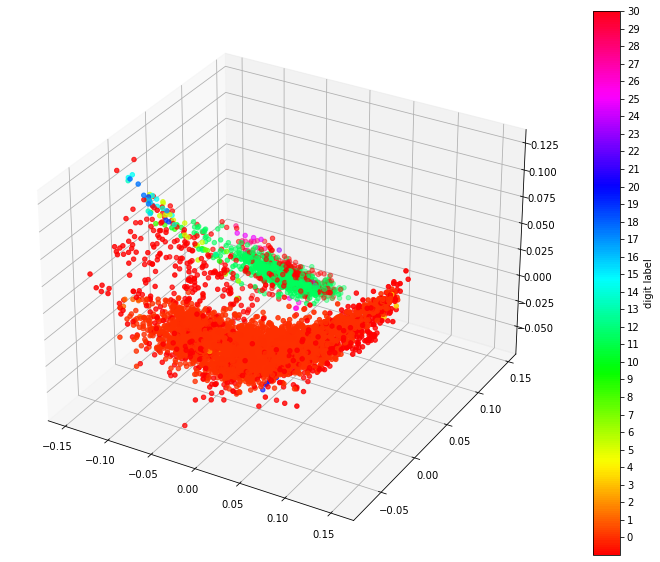

In [50]:
model = DBSCAN(eps=0.06, min_samples = 3)
y_predict = model.fit_predict(X)
print("DBSCAN purity", tot_purity(y_predict, kingdom_encoded))

print("Number of outliers", (y_predict == -1).sum())
ids, counts = np.unique(y_predict, return_counts=True)
print(pd.DataFrame(counts.reshape(1,-1), columns=ids, index=['']))

plot3d(X, labels=y_predict)

In [52]:
print("DBSCAN purity", tot_purity(y_predict, train["Kingdom"]))

DBSCAN purity 0.21074380164007928


The DBSCAN performs very badly.

## DNAtype

We repeat the same procedures used for Kingdom with DNAtype

## Data visualization - Dimensionality reduction

In [53]:
X = np.array(train.drop(["Kingdom","DNAtype","SpeciesID","Ncodons","SpeciesName"],axis=1))
X

array([[0.00546, 0.02297, 0.04054, ..., 0.00158, 0.00046, 0.00165],
       [0.01753, 0.01629, 0.02436, ..., 0.02141, 0.00047, 0.0031 ],
       [0.     , 0.03   , 0.00471, ..., 0.03118, 0.     , 0.00059],
       ...,
       [0.02818, 0.03481, 0.0105 , ..., 0.0011 , 0.     , 0.01713],
       [0.00175, 0.02413, 0.00671, ..., 0.01519, 0.00068, 0.00124],
       [0.00219, 0.0278 , 0.0256 , ..., 0.03438, 0.00146, 0.02304]])

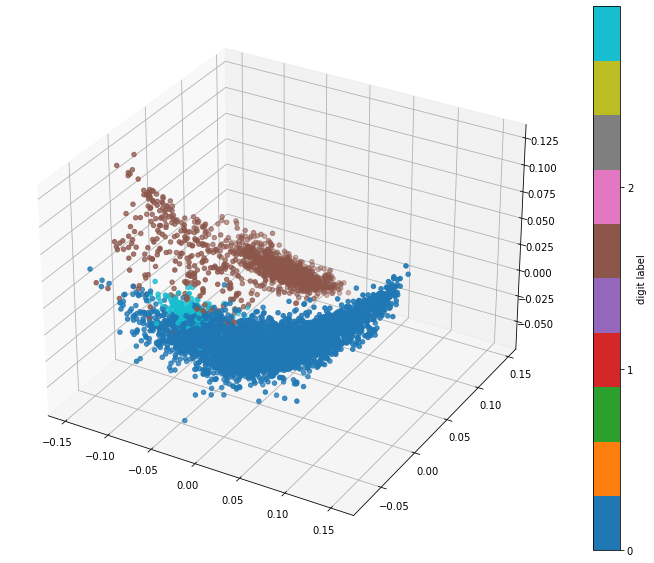

In [54]:
plot3d(X, labels=train["DNAtype"])

In this case the first visual insepction seems better than Kingdom, probably the clustering algorithms will perform better.

# Agglomerative hierarchical clustering

## Linkage methods

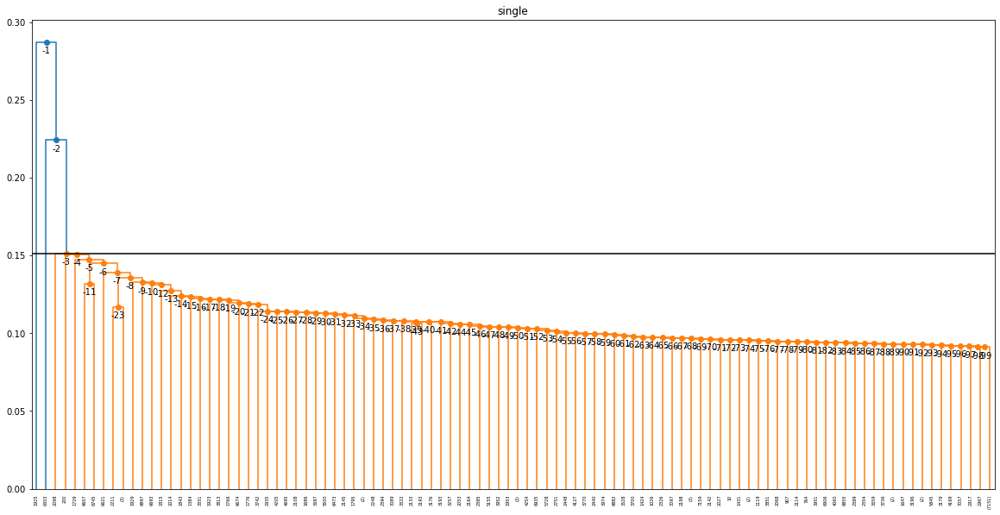

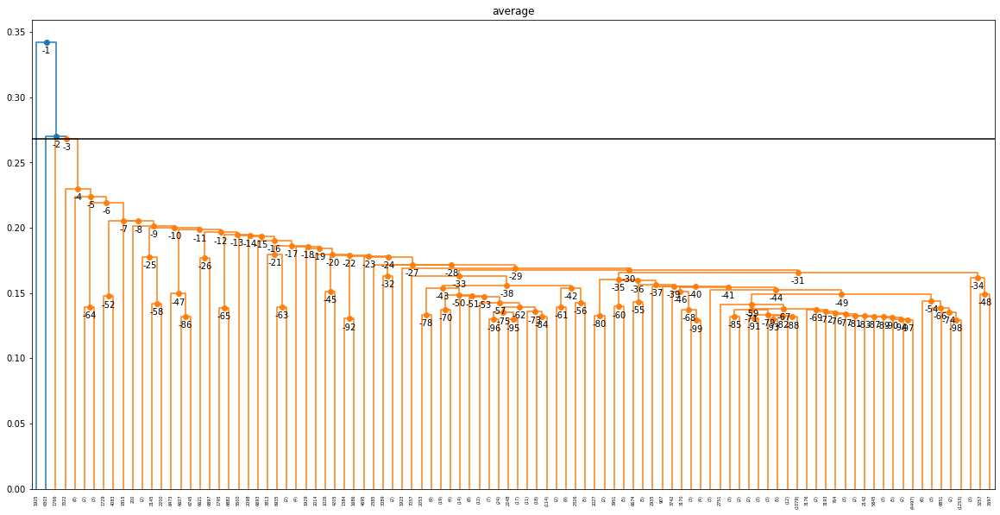

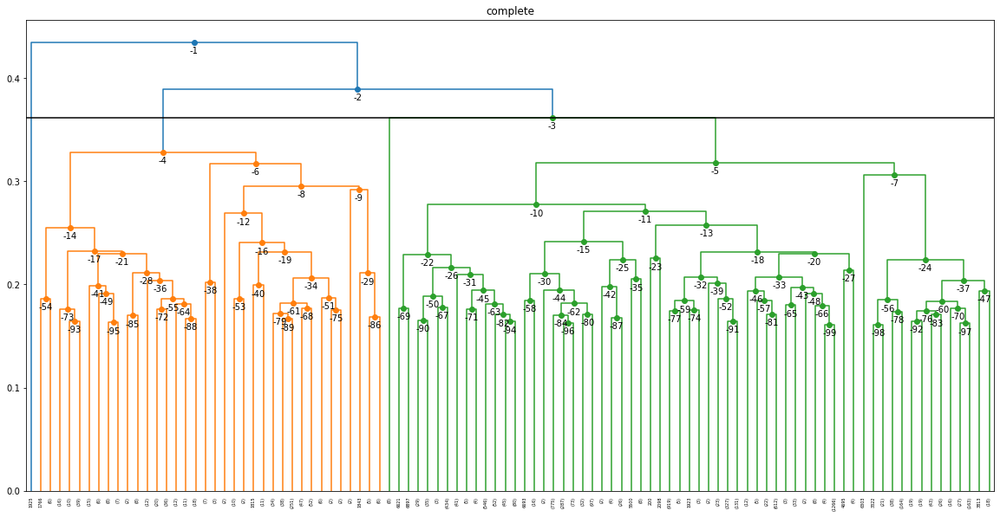

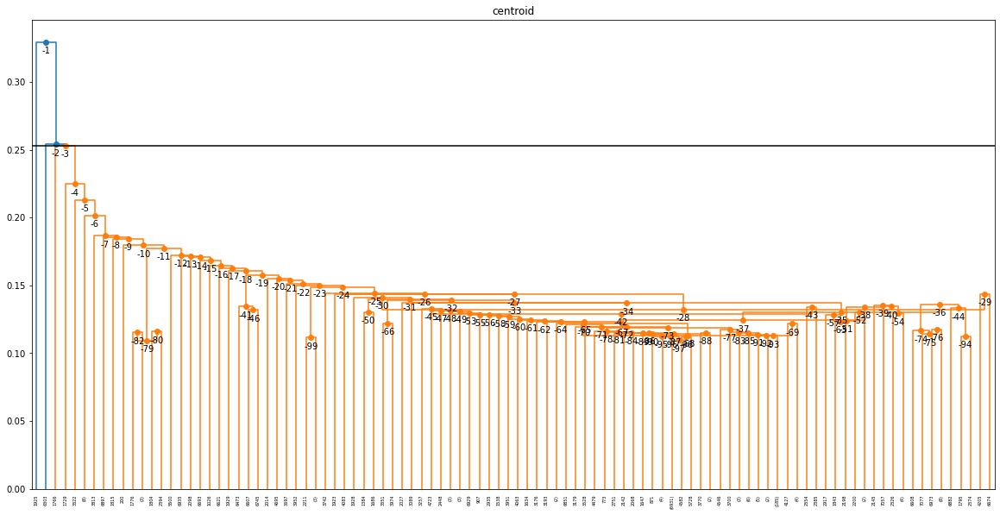

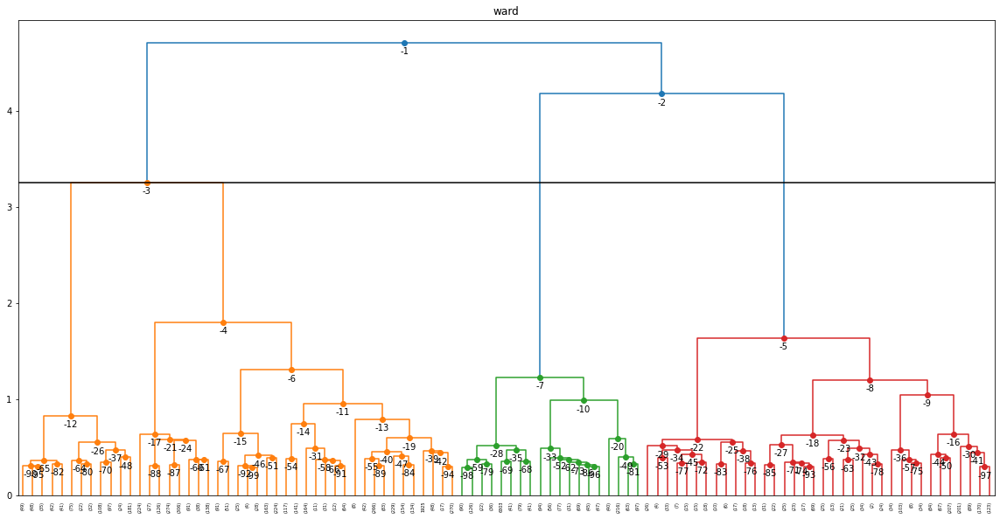

In [55]:
for method in methods:
    Z = linkage(X, metric='euclidean', method=method)
    fig, ax = plot_dendrogram(Z=Z, X=X, truncate_mode='lastp', 
                              p=100, n_clusters=3)
    ax.set_title(method)

Also in this case the best linkage method seems to be Ward, so we still use euclidean distance metric.

# Agglomerative clustering

We use the standard scikit-learn API, since it provides the fit() and predict() methods.

(<Figure size 1440x720 with 1 Axes>, <AxesSubplot:>)

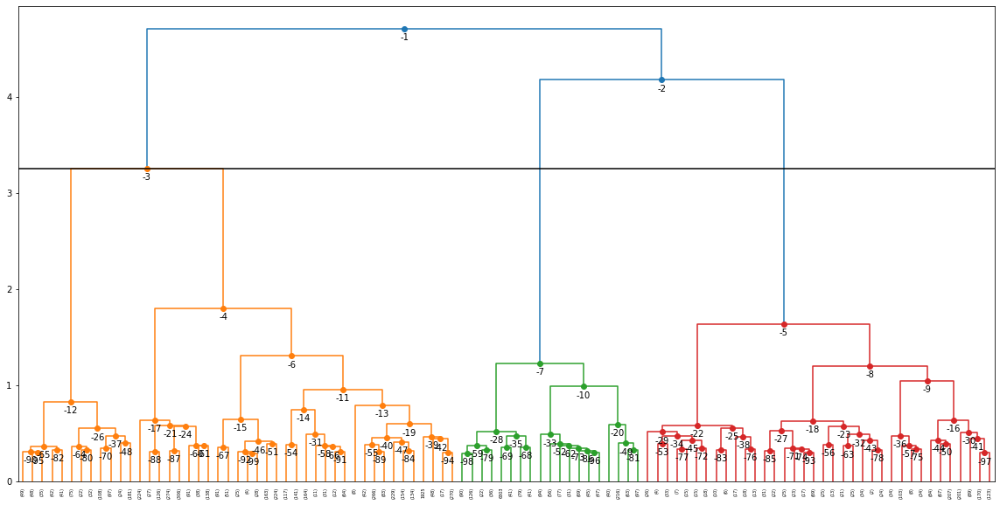

In [56]:
distance_threshold=None
n_clusters=3

model = AgglomerativeClustering(n_clusters=n_clusters, 
                                distance_threshold=distance_threshold, 
                                affinity='euclidean', linkage='ward')

y_predict = model.fit_predict(X)

plot_dendrogram(model=model, X=X, truncate_mode='lastp', p=100, 
                n_clusters=n_clusters, 
                color_threshold=distance_threshold)

We plot the sorted similarity matrix.

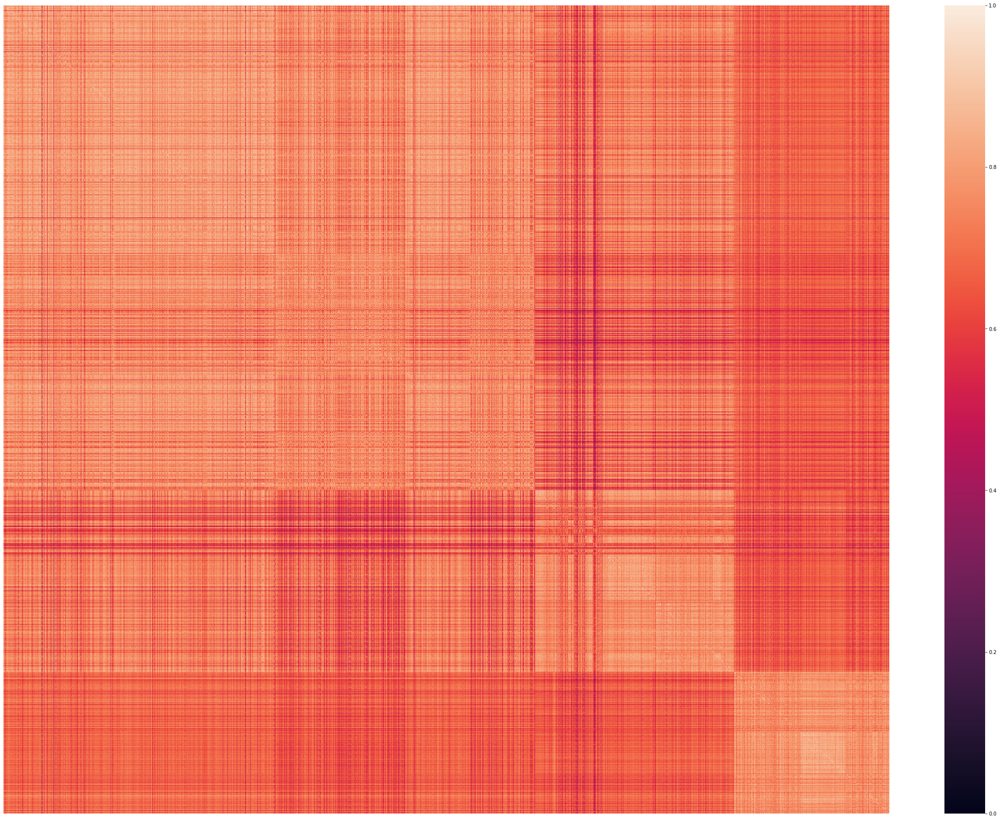

In [57]:
sim = similarity_mat(X, 'euclidean')
plot_sorted_mat(sim, y_predict)

We notice that in this case the matrix is better with respect to the Kingdom case. In fact, similar blocks are on the diagonal

In [58]:
print("Hierarchical clustering purity:", tot_purity(y_predict, train["DNAtype"]))

Hierarchical clustering purity: 0.8873278236880054


The purity is quite high, the clustering is good.

# K-means

We do the k.means with selected k = 3.

Kmeans purity 0.8929752066077329


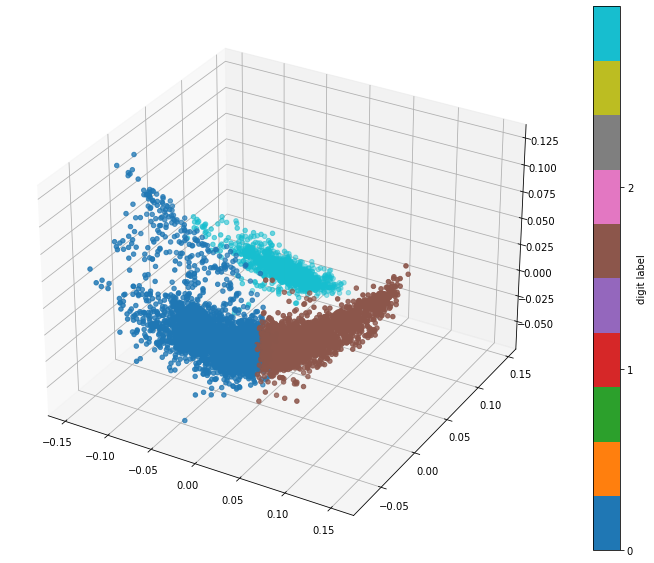

In [59]:
model = KMeans(n_clusters = 3, init='random', random_state=0)             
y_predict = model.fit_predict(X)
print("Kmeans purity", tot_purity(y_predict, train["DNAtype"]))

plot3d(X, labels=y_predict)

### Initialization

In [60]:
# Random
model = KMeans(n_clusters=3, init='random', random_state=0)             
print("Random Kmeans purity", tot_purity(model.fit_predict(X), train["DNAtype"]))

# K-Means++
model = KMeans(n_clusters=3, init='k-means++', random_state=0)             
print("Kmeans++ purity", tot_purity(model.fit_predict(X), train["DNAtype"]))

# Hierarchical
hmodel = AgglomerativeClustering(n_clusters=3, 
                                distance_threshold=distance_threshold, 
                                affinity='euclidean', linkage='ward')
y_predict = hmodel.fit_predict(X)
centroids = np.stack([X[y_predict == k].mean(0) for k in range(3)])
model = KMeans(n_clusters=3, init=centroids, n_init=1, random_state=0)             
print("Hierarchical+Kmeans purity", tot_purity(model.fit_predict(X), train["DNAtype"]))

Random Kmeans purity 0.8929752066077329
Kmeans++ purity 0.8929752066077328
Hierarchical+Kmeans purity 0.8929752066077329


All the k-means with different initializations have the same purity, the resul is very similar to the hierarchical agglomerative clustering.

We plot the sorted similarity matrix

K-means++


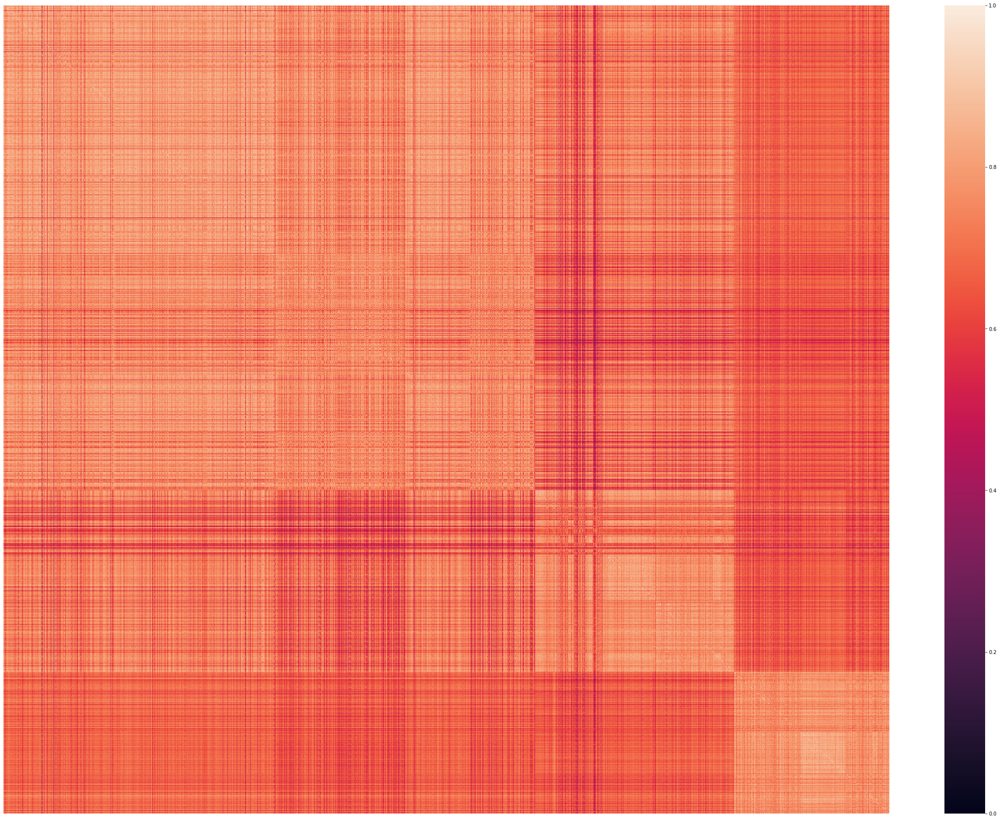

In [61]:
print("K-means++")
plot_sorted_mat(sim,y_predict)

It is possibile to distinguish 3 similar blocks on the diagonal.

The number of clusters we have chosen agree with the k indicated by the silhouette for both agglomerative clustering and k-means.

# DBSCAN

In [62]:
params = {'eps': np.arange(0.01,0.1,0.01), 'min_samples': range(1,6)}
cv = GridSearchCV(DBSCAN(), params, scoring=make_scorer(tot_purity), cv=3)
cv = cv.fit(X, train["DNAtype"])

In [63]:
print("The best parameters are:",cv.best_params_)
print("The score of this model is:",cv.best_score_)

pd.DataFrame(cv.cv_results_).sort_values(by="rank_test_score")

The best parameters are: {'eps': 0.060000000000000005, 'min_samples': 3}
The score of this model is: 0.7380165289163525


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_eps,param_min_samples,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
27,0.351985,0.002963,0.089339,0.010196,0.06,3,"{'eps': 0.060000000000000005, 'min_samples': 3}",0.726446,0.663223,0.824380,0.738017,0.066299,1
29,0.346017,0.016261,0.091487,0.007712,0.06,5,"{'eps': 0.060000000000000005, 'min_samples': 5}",0.704132,0.661983,0.811570,0.725895,0.062978,2
34,0.364989,0.004796,0.100729,0.003217,0.07,5,"{'eps': 0.06999999999999999, 'min_samples': 5}",0.838017,0.717355,0.613636,0.723003,0.091690,3
32,0.424523,0.031244,0.119634,0.008959,0.07,3,"{'eps': 0.06999999999999999, 'min_samples': 3}",0.832231,0.719835,0.614876,0.722314,0.088752,4
33,0.376870,0.016025,0.097591,0.006562,0.07,4,"{'eps': 0.06999999999999999, 'min_samples': 4}",0.831818,0.717769,0.614050,0.721212,0.088937,5
31,0.378264,0.033169,0.106787,0.013471,0.07,2,"{'eps': 0.06999999999999999, 'min_samples': 2}",0.830992,0.717355,0.614876,0.721074,0.088268,6
41,0.627993,0.046055,0.141954,0.002115,0.09,2,"{'eps': 0.09, 'min_samples': 2}",0.895455,0.585950,0.630579,0.703994,0.136603,7
42,0.490858,0.062864,0.119357,0.001723,0.09,3,"{'eps': 0.09, 'min_samples': 3}",0.894628,0.585950,0.630579,0.703719,0.136217,8
40,0.538505,0.010389,0.122611,0.004041,0.09,1,"{'eps': 0.09, 'min_samples': 1}",0.895041,0.584298,0.630992,0.703444,0.136815,9
43,0.453968,0.024951,0.119312,0.005491,0.09,4,"{'eps': 0.09, 'min_samples': 4}",0.894215,0.583058,0.630165,0.702479,0.136935,10


DBSCAN purity 0.6141873278196877
Number of outliers 1207
   -1     0    1    2    3    4    5    6    7    8   ...   20   21   22   23  \
  1207  4907    5    4    3    4   15    4    5    3  ...    3    3    3    3   

   24   25   26   27   28   29  
    4    4    4   17    3    3  

[1 rows x 31 columns]


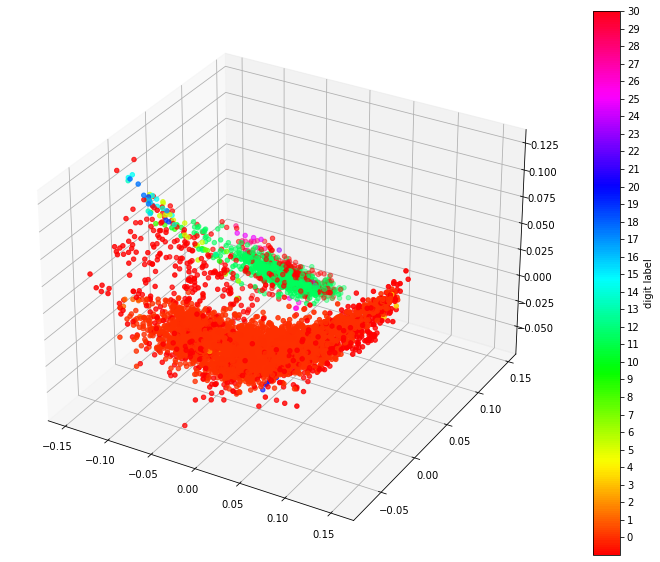

In [64]:
model = DBSCAN(eps=0.06, min_samples = 3)
y_predict = model.fit_predict(X)
print("DBSCAN purity", tot_purity(y_predict, train["DNAtype"]))

print("Number of outliers", (y_predict == -1).sum())
ids, counts = np.unique(y_predict, return_counts=True)
print(pd.DataFrame(counts.reshape(1,-1), columns=ids, index=['']))

plot3d(X, labels=y_predict)

The DBSCAN does not perform very well also with DNAtype.

## Conclusions

### Kingdom

The best performance is with k-means++. However this algorithm, like all the other clustering algorithms used, does not perform well. In fact, the sorted similairty matrix is not clear and the purity has a low score. The silhouette indicates 3 as the best number of clusters, but we have 10 kingdoms.


### DNAtype

On the other hand, the clustering for DNAtype is good, the best performer is k-means in general, all the different initializations have the same purity. The sorted similarity matrix has similar blocks on the diagonal and the purity is quite high. The silhouette score indicates that the best number of k should be 3, we have 3 DNA types.

# REQUEST 2

# Classification

Now we want to classify organisms into the 10 Kingdom classes according to their codon frequencies. We will use the different algorithms of supervised learning studied in the course and we will use also feature selection to see whether the accuracy increases.

We know that AGA and ACA frequencies are not present in the test set, for this reason is important to remove them also in the training set.

In [13]:
from sklearn.model_selection import cross_val_score
from sklearn.metrics import make_scorer, plot_confusion_matrix, accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.dummy import DummyRegressor, DummyClassifier
from sklearn.linear_model import LinearRegression, LogisticRegression, Perceptron
from sklearn import preprocessing
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis as QDA
from sklearn.feature_selection import SelectKBest
from sklearn.neighbors import KNeighborsClassifier
from sklearn.decomposition import PCA
from sklearn.svm import SVC
from matplotlib.ticker import (AutoMinorLocator, MultipleLocator)

In [14]:
t_cf_codons = train_codons.drop(["AGA","ACA"], axis=1)
t_cf_codons

UUU      UUC      UUA      UUG      CUU      CUC      CUA  \
Kingdom                                                                       
arc     3189  0.00546  0.02297  0.04054  0.01277  0.01527  0.01678  0.01915   
        9002  0.01753  0.01629  0.02436  0.01396  0.01148  0.00264  0.02219   
        279   0.00000  0.03000  0.00471  0.00529  0.02294  0.03353  0.00588   
        5871  0.00758  0.02887  0.00111  0.00696  0.00458  0.02973  0.00162   
        7707  0.00632  0.02607  0.00086  0.00544  0.01060  0.06950  0.00324   
...               ...      ...      ...      ...      ...      ...      ...   
vrt     3892  0.02725  0.01475  0.01930  0.02548  0.01896  0.02705  0.01515   
        659   0.03474  0.01549  0.01221  0.01127  0.01455  0.00892  0.00516   
        5001  0.02818  0.03481  0.01050  0.01271  0.03812  0.02044  0.02928   
        6347  0.00175  0.02413  0.00671  0.01261  0.01284  0.01888  0.00660   
        6798  0.00219  0.02780  0.02560  0.01353  0.03694  0.00988  0.04535   

                  CUG      AUU      AUC  ...      CGA      CGG      AGG  \
Kingdom                                  ...                              
arc     3189  0.00540  0.02653  0.00803  ...  0.00046  0.00026  0.01126   
        9002  0.01908  0.01924  0.01071  ...  0.00078  0.00078  0.01117   
        279   0.01941  0.01765  0.01588  ...  0.00118  0.00588  0.03176   
        5871  0.03042  0.00353  0.03304  ...  0.00609  0.02057  0.00139   
        7707  0.02462  0.00797  0.03005  ...  0.00876  0.02377  0.00123   
...               ...      ...      ...  ...      ...      ...      ...   
vrt     3892  0.02548  0.02263  0.01420  ...  0.00557  0.00197  0.01909   
        659   0.02676  0.01268  0.01737  ...  0.00047  0.00235  0.00751   
        5001  0.02707  0.03260  0.03315  ...  0.00994  0.00552  0.00055   
        6347  0.03795  0.01630  0.02592  ...  0.00415  0.00513  0.01206   
        6798  0.01756  0.04755  0.02158  ...  0.00841  0.00402  0.00000   

                  GAU      GAC      GAA      GAG      UAA      UAG      UGA  
Kingdom                                                                      
arc     3189  0.02732  0.01830  0.04259  0.02027  0.00158  0.00046  0.00165  
        9002  0.02529  0.00434  0.04608  0.02591  0.02141  0.00047  0.00310  
        279   0.02000  0.01059  0.04118  0.05706  0.03118  0.00000  0.00059  
        5871  0.01201  0.00244  0.01877  0.05100  0.00660  0.00099  0.00174  
        7707  0.01767  0.00070  0.03344  0.05470  0.01227  0.00106  0.00166  
...               ...      ...      ...      ...      ...      ...      ...  
vrt     3892  0.03275  0.00795  0.06958  0.02936  0.00503  0.00020  0.00041  
        659   0.03052  0.02160  0.06338  0.04085  0.02160  0.00610  0.00094  
        5001  0.01050  0.01160  0.00663  0.01878  0.00110  0.00000  0.01713  
        6347  0.02316  0.02710  0.02168  0.03658  0.01519  0.00068  0.00124  
        6798  0.00695  0.01463  0.01902  0.00658  0.03438  0.00146  0.02304  

[7260 rows x 62 columns]

# Logistic regression

Logistic regression is the first algorithm that we use.

In logistic regression, we model p(X) using a function that gives outputs between 0 and 1 for all values of X by regressing the logistic function, which is bounded between 0 and 1. We do this using the maximum likelihood algorithm (MLE).

This is the relation:

$p(Y|X)=\frac{e^{\beta_{0}+\beta_{1} X}}{1+e^{\beta_{0}+\beta_{1} X}}$

We fit the model on the training data.

In [69]:
model = LogisticRegression(solver="newton-cg", penalty='none')  
model.fit(t_cf_codons, train["Kingdom"])

LogisticRegression(penalty='none', solver='newton-cg')

We define our first metric of interest: accuracy. It is the proportion of correct predictions in all predictions made.

In [15]:
def accuracy(y_pred, y_true):
    return (y_pred == y_true).sum() / y_pred.shape[0]

We compute the accuracy for the train set and the test set. The second one is computed performing a 5-fold cross validation and averaging the accuracy of all folds.

In [71]:
print("Train accuracy:", accuracy(train["Kingdom"], model.predict(t_cf_codons)))
cv_log = cross_val_score(model, t_cf_codons, train["Kingdom"], scoring=make_scorer(accuracy), cv=5, n_jobs=-1)
print("CV accuracy: ",np.mean(cv_log))

Train accuracy: 0.8596418732782369
CV accuracy:  0.8254820936639119


Now we use feature selection to see if a decrease in features increase the performance on the test set. There are some ways to accomplish this task, we will use two different types of regularization: lasso and ridge regression. These methods work adding a penalization that depends on the hyperparameter C. We have to optimize C and scale the features in order to have meaningful results. Since we have 5 folds in cross validation, the scaling is applied to each one, so we need to use the Pipeline object.

## Lasso

We do a grid search to tune the C parameter.

In [72]:
C2=np.arange(0.1, 1.5, 0.1)
model=Pipeline([('scaler',preprocessing.StandardScaler()), 
               ('classifier',LogisticRegression(solver='saga', penalty='l1',max_iter=4000))])

params = {'classifier__C': C2}
cv = GridSearchCV(model, params, refit=True, cv=5, n_jobs=-1,
                  verbose=False,
                  scoring=make_scorer(accuracy))
cv.fit(t_cf_codons, train["Kingdom"])
print("Done!")

Done!


In [73]:
pd.DataFrame(cv.cv_results_).sort_values(by="rank_test_score")

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__C,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
3,108.698330,17.954696,0.006715,0.003378,0.4,{'classifier__C': 0.4},0.827135,0.831267,0.827135,0.842975,0.821625,0.830028,0.007163,1
5,127.533602,16.168620,0.006882,0.002350,0.6,{'classifier__C': 0.6},0.825069,0.829201,0.830579,0.840909,0.823691,0.829890,0.006067,2
6,137.306890,18.311180,0.003251,0.003732,0.7,{'classifier__C': 0.7000000000000001},0.825758,0.831956,0.826446,0.839532,0.823691,0.829477,0.005722,3
2,96.593744,21.490604,0.006282,0.003742,0.3,{'classifier__C': 0.30000000000000004},0.826446,0.829201,0.825758,0.842287,0.820937,0.828926,0.007192,4
4,119.021491,17.594078,0.004524,0.004314,0.5,{'classifier__C': 0.5},0.826446,0.829201,0.826446,0.840220,0.822314,0.828926,0.006061,4
7,141.193929,16.743024,0.005188,0.003629,0.8,{'classifier__C': 0.8},0.826446,0.829201,0.824380,0.840909,0.823003,0.828788,0.006411,6
8,146.535725,21.455746,0.004625,0.003440,0.9,{'classifier__C': 0.9},0.823003,0.828512,0.823691,0.840909,0.822314,0.827686,0.006961,7
11,154.016669,21.478747,0.005722,0.002902,1.2,{'classifier__C': 1.2000000000000002},0.824380,0.828512,0.824380,0.839532,0.821625,0.827686,0.006318,7
12,159.170002,20.438819,0.006495,0.003635,1.3,{'classifier__C': 1.3000000000000003},0.824380,0.829890,0.824380,0.840220,0.819559,0.827686,0.007069,7
13,134.252959,20.371937,0.002069,0.004138,1.4,{'classifier__C': 1.4000000000000001},0.824380,0.829201,0.824380,0.840220,0.819559,0.827548,0.007032,10


We plot the variation of the score according to C parameters values.

The best parameters are: {'classifier__C': 0.4}
The CV score of this model is: 0.8300275482093664


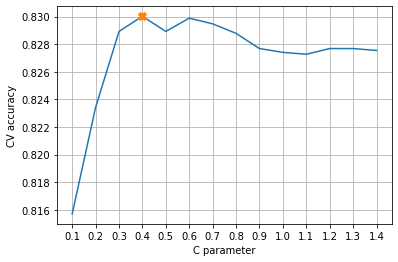

In [74]:
fig=plt.figure()
ax = fig.gca()
plt.plot(C2,cv.cv_results_["mean_test_score"])
ax.xaxis.set_major_locator(MultipleLocator(0.1))
plt.grid()
plt.plot(cv.best_params_["classifier__C"],cv.best_score_,marker="X",markersize=8)
plt.xlabel("C parameter")
plt.ylabel("CV accuracy")
print("The best parameters are:",cv.best_params_)
print("The CV score of this model is:",cv.best_score_)

We fit the model using the the best C.

In [75]:
model_l1 = Pipeline([('scaler',preprocessing.StandardScaler()), 
               ('classifier',LogisticRegression(solver='saga', penalty='l1',C=0.4,max_iter=4000))])
model_l1.fit(t_cf_codons, train["Kingdom"])

Pipeline(steps=[('scaler', StandardScaler()),
                ('classifier',
                 LogisticRegression(C=0.4, max_iter=4000, penalty='l1',
                                    solver='saga'))])

In [76]:
print("Train accuracy:", accuracy(train["Kingdom"], model_l1.predict(t_cf_codons)))
cv_lasso = cross_val_score(model_l1, t_cf_codons, train["Kingdom"], scoring=make_scorer(accuracy), cv=5, n_jobs=-1)
print("CV accuracy: ",np.mean(cv_lasso))

Train accuracy: 0.8486225895316805
CV accuracy:  0.8298898071625344


## Ridge regression

The main difference between ridge and lasso is that the latter produces simpler and more interpretable models that involve only a subset of the predictors. In fact, lasso, can result in coefficient estimates that are exactly equal to 0. However, lasso do not outperforms ridge regression in general, in fact in a dataset where each predictor is related to response, the ridge has a better accuracy.

In [79]:
C2=np.arange(0.1, 1.5, 0.1)
model=Pipeline([('scaler',preprocessing.StandardScaler()), 
               ('classifier',LogisticRegression(solver='saga', penalty='l2',max_iter=4000))])

params = {'classifier__C': C2}
cv = GridSearchCV(model, params, refit=True, cv=5, n_jobs=-1,
                  verbose=False,
                  scoring=make_scorer(accuracy))
cv.fit(t_cf_codons, train["Kingdom"])
print("Done!")

Done!


In [80]:
pd.DataFrame(cv.cv_results_).sort_values(by="rank_test_score")

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__C,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
3,51.450879,10.182363,0.010208,0.001998,0.4,{'classifier__C': 0.4},0.827135,0.829201,0.828512,0.836777,0.827824,0.829890,0.003512,1
8,65.433042,11.453649,0.006435,0.003603,0.9,{'classifier__C': 0.9},0.828512,0.827135,0.825758,0.842975,0.825069,0.829890,0.006649,1
9,67.155112,9.388922,0.007777,0.004022,1.0,{'classifier__C': 1.0},0.828512,0.827824,0.826446,0.841598,0.825069,0.829890,0.005972,1
10,70.552254,11.014977,0.006411,0.003677,1.1,{'classifier__C': 1.1},0.827824,0.827135,0.828512,0.840909,0.825069,0.829890,0.005629,1
6,57.901282,9.474610,0.007905,0.001827,0.7,{'classifier__C': 0.7000000000000001},0.827135,0.827135,0.824380,0.842287,0.827135,0.829614,0.006425,5
7,61.745836,10.204657,0.006666,0.003499,0.8,{'classifier__C': 0.8},0.827135,0.826446,0.825758,0.842975,0.825758,0.829614,0.006700,5
4,54.336339,13.646605,0.004425,0.002945,0.5,{'classifier__C': 0.5},0.825069,0.829890,0.827135,0.837466,0.827135,0.829339,0.004343,7
2,45.114217,10.685864,0.007147,0.003432,0.3,{'classifier__C': 0.30000000000000004},0.827824,0.829890,0.827135,0.836088,0.825069,0.829201,0.003772,8
5,54.034180,9.412628,0.006679,0.003003,0.6,{'classifier__C': 0.6},0.826446,0.827135,0.825758,0.839532,0.827135,0.829201,0.005190,8
11,73.969280,10.951002,0.007382,0.003148,1.2,{'classifier__C': 1.2000000000000002},0.826446,0.827824,0.826446,0.840909,0.823691,0.829063,0.006073,10


The best parameters are: {'classifier__C': 0.4}
The CV score of this model is: 0.8298898071625345


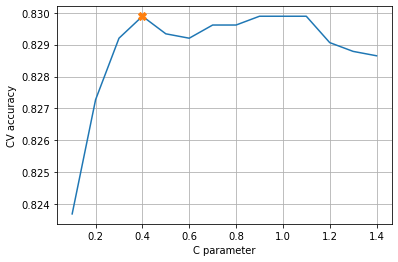

In [81]:
fig=plt.figure()
ax = fig.gca()
plt.plot(C2,cv.cv_results_["mean_test_score"])
#ax.xaxis.set_major_locator(MultipleLocator(0.1))
plt.grid()
plt.plot(cv.best_params_["classifier__C"],cv.best_score_,marker="X",markersize=8)
plt.xlabel("C parameter")
plt.ylabel("CV accuracy")
print("The best parameters are:",cv.best_params_)
print("The CV score of this model is:",cv.best_score_)

In [82]:
model_l2 = Pipeline([('scaler',preprocessing.StandardScaler()), 
               ('classifier',LogisticRegression(solver='saga', penalty='l2',C=0.4,max_iter=4000))])
model_l2.fit(t_cf_codons,train["Kingdom"])

print("Train accuracy:", accuracy(train["Kingdom"], model_l2.predict(t_cf_codons)))
cv_ridge = cross_val_score(model_l2, t_cf_codons, train["Kingdom"], scoring=make_scorer(accuracy), cv=5, n_jobs=-1)
print("CV accuracy: ",np.mean(cv_ridge))

Train accuracy: 0.8512396694214877
CV accuracy:  0.8296143250688706


Logistc, Lasso and Ridge regression have similar performances.

# Linear discriminant analysis

LDA models posterior probabilities as a linear function fo x. The relation is found through the Bayes Theorem. LDA assumes that the features come from a multivariate Gaussian distribution with a common covariance matrix for all classes.

We fit the model on the training data and we compute the accuracy.

In [83]:
model = LDA()
model = model.fit(t_cf_codons, train["Kingdom"])

print("Train accuracy:", accuracy(train["Kingdom"], model.predict(t_cf_codons)))
cv_lda = cross_val_score(model, t_cf_codons, train["Kingdom"], scoring=make_scorer(accuracy), cv=5,n_jobs=-1)
print("CV score:", np.mean(cv_lda))

Train accuracy: 0.7995867768595041
CV score: 0.7889807162534435


We try forward feature selection to see if we can select a smaller number of features.

## Forward feature selection

In [84]:
def get_evaluator(scorer):
    def evaluator(model, X, y, trained=False):
        if not trained:
            model = model.fit(X, y)
        score = scorer(model, X, y)
        return model, score
    return evaluator   

def get_cv_evaluator(scorer, cv=3):
    def evaluator(model, X, y, trained=False):            
        scores = cross_val_score(model, X, y, scoring=scorer, cv=cv, n_jobs=-1)
        if not trained:
            model = model.fit(X, y)
        return model, np.mean(scores)
    
    return evaluator

def get_val_evaluator(scorer, val_size=0.1):
    def evaluator(model, X, y, trained=False):
        X_train_small, X_val, y_train_small, y_val = train_test_split(X, y, 
                                                                      test_size=val_size,
                                                                      random_state=0)
        
        if not trained:
            model = model.fit(X_train_small, y_train_small)
        score = scorer(model, X_val, y_val) 
        
        return model, score
    
    return evaluator

In [85]:
def forward_selection(Xtrain_pd, ytrain, candidates_evaluator, candidates_argbest, # Metric to be used at 2.b
                      subsets_evaluator, subsets_argbest,       # Metric to be used at 3
                      candidates_scorer_name=None,  # Name of 2. figure
                      subsets_scorer_name=None,     # Name of 3. figure
                      verbose=True, weight_step3=0,
                      dummyModel = DummyRegressor,mod = LinearRegression,**kwargs):   # estimator and parameters

    # Global variable init
    # ====================
    num_features = Xtrain_pd.shape[-1]
    best_candidate_metric = []
    # subsets_* are lists containing one value for each Mk model (the best of the Mk candidates)
    subsets_metric = []        # The best metric of each subset of dimension 'dim'
    subsets_best_features = [] # The best features combination in each subset of dimension 'dim'
    # A figure to keep track of candidates scores in each Mk subset
    plt.figure()
    candidate_fig = plt.subplot(111) # A global matplotlib figure
    num_evaluations = 0        # A conter to keep track of the total number of trials

    selected_features = []
    all_features = Xtrain_pd.columns


    # 1. Train M0
    # ===========
    model = dummyModel()
    # Compute (2.b) metrics
    model, score = candidates_evaluator(model, Xtrain_pd[[]], ytrain)
    best_candidate_metric.append(score)
    subsets_best_features.append([])
    _ = candidate_fig.scatter([0], [score], color="b")
    # Compute metric for step 3.
    _, score = subsets_evaluator(model, Xtrain_pd[[]], ytrain, trained=True)
    subsets_metric.append(score)
    score_3=score

    # 2. Evaluate all Mk candidates with
    #    k=0...P features
    # =========================================
    for dim in range(1,len(all_features)+1):
        candidate_metrics = [] # Keep track of candidates metrics. Will be used to select the best
        candidate_models = []  # Keep track of candidates trained models

        # 2.a Fixed the number of features 'dim', look at
        #     all the possible candidate models with that
        #     cardinality
        # ===============================================
        remaining_features = all_features.difference(selected_features)

        for new_column in remaining_features:
            Xtrain_sub = Xtrain_pd[selected_features+[new_column]].to_numpy()
            model = mod(**kwargs)
            model, score = candidates_evaluator(model, Xtrain_sub, ytrain)
            candidate_models.append(model)
            candidate_metrics.append(score)
            num_evaluations += 1

        _ = candidate_fig.scatter([Xtrain_sub.shape[-1]]*len(candidate_metrics), candidate_metrics,
                                  color="b")

        # 2.b Select the best candidate among those using
        #     the same number of features (2.a)
        # ===============================================
        idx_best_candidate = candidates_argbest(candidate_metrics)
        # Update selected feature
        selected_features.append(remaining_features[idx_best_candidate])
        # Save best candidate features
        best_candidate_metric.append(candidate_metrics[idx_best_candidate])
        best_features = selected_features.copy()
        subsets_best_features.append(best_features)


        # Compute metric for step 3.
        best_subset_model = candidate_models[idx_best_candidate]
        best_subset_Xtrain = Xtrain_pd[best_features].to_numpy()
        _, score = subsets_evaluator(best_subset_model, best_subset_Xtrain, ytrain, trained=True)
        subsets_metric.append(score)
        num_evaluations += weight_step3 

        if verbose:
            print("............")
            print("Best model (M{}) with {} features: {}".format(dim, dim, best_features))
            print("M{} subset score (3.): {}".format(dim, score))

    # 3. Among all best candidates with increasing number
    #    of features, select the best one
    # ===================================================
    best_subset_idx = subsets_argbest(subsets_metric)
    best_features = subsets_best_features[best_subset_idx]

    if verbose:
        print("\n\nBest configuration has {} features".format(best_subset_idx))
        print("Features: {}".format(subsets_best_features[best_subset_idx]))
        print("Total number of trained models:", num_evaluations)

    # Complete the subsets_fig figure by plotting
    # a line connecting all best candidate score
    best_candidate_score_idx = candidates_argbest(best_candidate_metric)
    _ = candidate_fig.plot(range(len(best_candidate_metric)), best_candidate_metric)
    _ = candidate_fig.scatter(best_candidate_score_idx, best_candidate_metric[best_candidate_score_idx],
                          marker='X', label="Best", color="r")
    candidate_fig.set_title(candidates_scorer_name)
    candidate_fig.legend()
 
    # Plot a figure to show how te 3. metric evolves
    plt.figure()
    subsets_fig = plt.subplot(111)
    _ = subsets_fig.plot(range(len(subsets_metric)), subsets_metric, label="Selection (3.) scores")
    _ = subsets_fig.scatter(best_subset_idx, subsets_metric[best_subset_idx],
                          marker='X', label="Best (3.) score", color="r")
    subsets_fig.set_title(subsets_scorer_name)
    subsets_fig.legend()
    return(best_features)#,best_score,subsets_metric)

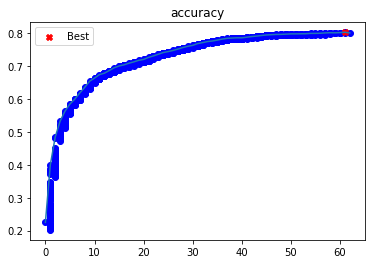

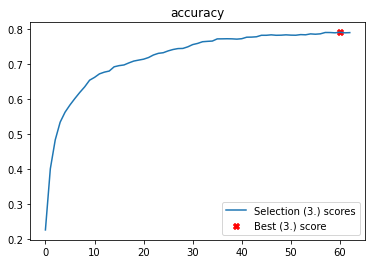

In [86]:
bf_lda = forward_selection(t_cf_codons, train["Kingdom"],
                           get_evaluator(make_scorer(accuracy)), np.argmax, # 2.b
                           get_cv_evaluator(make_scorer(accuracy), cv=5), np.argmax, # 3.
                           candidates_scorer_name="accuracy",
                           subsets_scorer_name="accuracy", verbose = False,
                           dummyModel=DummyClassifier,mod=LDA)

In [87]:
print(len(bf_lda), "features were selected")
print(bf_lda)

60 features were selected
['CUA', 'AGG', 'UGU', 'CUU', 'GAU', 'UCC', 'ACU', 'UUC', 'AUU', 'CCC', 'UCA', 'ACG', 'CCA', 'AUA', 'CUG', 'AGC', 'UAC', 'GAG', 'GUG', 'UGA', 'CCG', 'GGA', 'AUC', 'AUG', 'CAU', 'GCA', 'UGC', 'GUC', 'UCG', 'AAA', 'UAU', 'AAG', 'CCU', 'CGG', 'GGC', 'CAA', 'CAG', 'CUC', 'GGU', 'UUA', 'UUG', 'GCC', 'UAG', 'UCU', 'AAU', 'AAC', 'UAA', 'GCU', 'ACC', 'GUU', 'UUU', 'GAC', 'AGU', 'GAA', 'GUA', 'CGC', 'GGG', 'UGG', 'CGU', 'GCG']


All the features but two are selected, so it is necessary to re-fit the model.

In [89]:
model_lda_reduced=LDA()
model_lda_reduced.fit(t_cf_codons[bf_lda], train["Kingdom"])
print("Train accuracy:", accuracy(train["Kingdom"], model_lda_reduced.predict(t_cf_codons[bf_lda])))
cv_ldared = cross_val_score(model_lda_reduced, t_cf_codons[bf_lda], train["Kingdom"], scoring=make_scorer(accuracy), cv=5,n_jobs=-1)
print("CV score:", np.mean(cv_ldared))

Train accuracy: 0.8005509641873279
CV score: 0.7900826446280991


The improvement is not very significant.

# Quadratic Discriminant Analysis

If in LDA we remove the assumption that density functions (multivariate gaussians distributions) must have the same covariance matrix, then we obtain a quadratic relation.

We fit the model and asses the accuracy.

In [90]:
model = QDA(store_covariance=True)
model = model.fit(t_cf_codons, train["Kingdom"])

print("Train accuracy:", accuracy(train["Kingdom"], model.predict(t_cf_codons)))
cv_qda = cross_val_score(model, t_cf_codons, train["Kingdom"], scoring=make_scorer(accuracy), cv=5)
print("CV score:", np.mean(cv_qda))

Train accuracy: 0.8842975206611571


C:\Users\proca\anaconda3\lib\site-packages\sklearn\discriminant_analysis.py:808: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
C:\Users\proca\anaconda3\lib\site-packages\sklearn\discriminant_analysis.py:808: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
C:\Users\proca\anaconda3\lib\site-packages\sklearn\discriminant_analysis.py:808: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
C:\Users\proca\anaconda3\lib\site-packages\sklearn\discriminant_analysis.py:808: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


CV score: 0.8073002754820935


C:\Users\proca\anaconda3\lib\site-packages\sklearn\discriminant_analysis.py:808: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


We get some warnings due to collinearity, this can affect the goodness of the method. So, we decide to use feature selection, this might help QDA algorithm to perform better.

## Forward feature selection

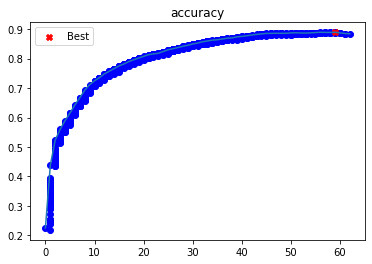

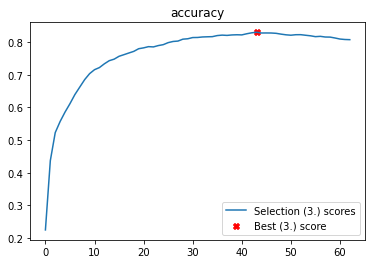

In [91]:
bf_qda =forward_selection(t_cf_codons, train["Kingdom"],
                          get_evaluator(make_scorer(accuracy)), np.argmax, # 2.b
                          get_cv_evaluator(make_scorer(accuracy), cv=5), np.argmax, # 3.
                          candidates_scorer_name="accuracy",
                          subsets_scorer_name="accuracy", verbose = False,
                          dummyModel=DummyClassifier, mod=QDA)

In [92]:
print(len(bf_qda), "features are selected")
print(bf_qda)

43 features are selected
['CUA', 'AGG', 'CUU', 'UGU', 'GCC', 'GAA', 'UUC', 'CUG', 'CCC', 'CCU', 'AAG', 'GGA', 'CCA', 'GAU', 'GGC', 'GGG', 'UCG', 'UUG', 'UAC', 'AGC', 'UAU', 'AUG', 'ACU', 'GAG', 'AUA', 'GCA', 'UCA', 'AUC', 'UCC', 'CAU', 'AUU', 'UGC', 'CGG', 'GUC', 'ACG', 'AGU', 'CGA', 'CCG', 'CAC', 'CAA', 'CAG', 'UGG', 'GUA']


We see that 43 features are selected. So we re-fit the model with the selected features.

In [93]:
model_qda_reduced=QDA()
model_qda_reduced.fit(t_cf_codons[bf_qda], train["Kingdom"])
print("Train accuracy:", accuracy(train["Kingdom"], model_qda_reduced.predict(t_cf_codons[bf_qda])))
cv_qdared = cross_val_score(model_qda_reduced, t_cf_codons[bf_qda], train["Kingdom"], scoring=make_scorer(accuracy), cv=5,n_jobs=-1)
print("CV score:", np.mean(cv_qdared))

Train accuracy: 0.8820936639118457
CV score: 0.8300275482093664


The performance on the test set improves.

# Support vector machine

SVM are classifiers which find the hyperplane that maximizes the distance between the data points and the boundary, they take into account some classification errors. In SVM we can use the Kernel Trick which enlarge our feature space in order to accommodate a non-linear boundary between the classes. Starting from the Linear kernel we will use also:

RBF (Radial Basis Function) Kernel:  $K\left(\mathbf{x}, \mathbf{x}^{\prime}\right)=\exp \left(-\gamma\left\|\boldsymbol{x}-\boldsymbol{x}^{\prime}\right\|^{2}\right)\quad$ where $\gamma$ is specified by parameter `gamma`, must be greater than 0

Polynomial Kernel: $K\left(\mathbf{x}, \mathbf{x}^{\prime}\right)=\left(\gamma\left\langle x, x^{\prime}\right\rangle+r\right)^{d}\quad$ where $d$ is specified by parameter `degree`, $r$ by `coef0`

Sigmoid Kernel: $K\left(\mathbf{x}, \mathbf{x}^{\prime}\right) = \tanh \left(\gamma\left\langle x, x^{\prime}\right\rangle+r\right)\quad$ where $r$ is specified by `coef0`, $\gamma$ is specified by parameter `gamma`

## Linear kernel

In [94]:
# Train an SVM classifier
svm_model = SVC(kernel='linear', C= 1e3)
svm_model.fit(t_cf_codons, train["Kingdom"])

train_acc = accuracy_score(svm_model.predict(t_cf_codons), train["Kingdom"])
test_acc = accuracy_score(svm_model.predict(test_codons), test["Kingdom"])

print("SVM train accuracy:", train_acc)
cv_svm = cross_val_score(svm_model, t_cf_codons, train["Kingdom"], scoring=make_scorer(accuracy), cv=5,n_jobs=-1)
print("SVM CV score:", np.mean(cv_svm))
print("SVM test accuracy:", test_acc)

SVM train accuracy: 0.8753443526170799
SVM CV score: 0.8476584022038567
SVM test accuracy: 0.8507520246818358


## Polynomial kernel

With polynomial kernel we optimize for: C, the degree of the polynomial and the coefficient.

In [95]:
# Polynomial
param_grid = {'C': np.linspace(0.001, 100, 5),
              'coef0': np.linspace(-10, 10, 5),
              'degree': [2, 3, 4, 5, 6]}
svm_poly = GridSearchCV(SVC(kernel='poly'), param_grid,
                        cv=5, scoring='accuracy', refit=True,
                        verbose = False, n_jobs=-1)
svm_poly.fit(t_cf_codons, train["Kingdom"])
print("Done!")

Done!


In [96]:
svm_poly.best_params_

{'C': 25.00075, 'coef0': 0.0, 'degree': 5}

In [97]:
svm_model = SVC(kernel='poly', C=25.001, coef0=0, degree=5)
svm_model.fit(t_cf_codons, train["Kingdom"])

train_acc = accuracy_score(svm_model.predict(t_cf_codons), train["Kingdom"])
test_acc = accuracy_score(svm_model.predict(test_codons), test["Kingdom"])

print("SVM train accuracy:", train_acc)
cv_svm = cross_val_score(svm_model, t_cf_codons, train["Kingdom"], scoring=make_scorer(accuracy), cv=5,n_jobs=-1)
print("SVM CV score:", np.mean(cv_svm))
print("SVM test accuracy:", test_acc)

SVM train accuracy: 1.0
SVM CV score: 0.896831955922865
SVM test accuracy: 0.9001156961048978


## RBF kernel

With RBF kernel we optimize for C and gamma.

In [98]:
# RBF
param_grid = {'C': np.linspace(0.001, 100, 5),
              'gamma': np.linspace(0.001, 100, 5)}
rbf_poly = GridSearchCV(SVC(kernel='rbf'), param_grid, 
                        cv=5, scoring='accuracy', refit=True,
                        verbose=False, n_jobs=-1)
rbf_poly.fit(t_cf_codons, train["Kingdom"])
print("Done!")

Done!


In [99]:
rbf_poly.best_params_

{'C': 25.00075, 'gamma': 75.00025}

In [102]:
svm_model = SVC(kernel='rbf', C=25.001, gamma= 75.00025)
svm_model.fit(t_cf_codons, train["Kingdom"])

train_acc = accuracy_score(svm_model.predict(t_cf_codons), train["Kingdom"])
test_acc = accuracy_score(svm_model.predict(test_codons), test["Kingdom"])

print("SVM train accuracy:", train_acc)
cv_svm = cross_val_score(svm_model, t_cf_codons, train["Kingdom"], scoring=make_scorer(accuracy), cv=5,n_jobs=-1)
print("SVM CV score:", np.mean(cv_svm))
print("SVM test accuracy:", test_acc)

SVM train accuracy: 0.9949035812672177
SVM CV score: 0.9103305785123966
SVM test accuracy: 0.9139992286926341


## Sigmoid kernel

With Sigmoid kernel we optimize: C, gamma and the coefficient.

In [103]:
# Sigmoid
param_grid = {'C': np.linspace(0.001, 100, 5),
              'gamma': np.linspace(0.001, 100, 5),
              'coef0': np.linspace(-10, 10, 5)}
sigm_poly = GridSearchCV(SVC(kernel='sigmoid'), param_grid, 
                         cv=5, scoring='accuracy', refit=True,
                         verbose=False, n_jobs=-1)
sigm_poly.fit(t_cf_codons, train["Kingdom"])

GridSearchCV(cv=5, estimator=SVC(kernel='sigmoid'), n_jobs=-1,
             param_grid={'C': array([1.000000e-03, 2.500075e+01, 5.000050e+01, 7.500025e+01,
       1.000000e+02]),
                         'coef0': array([-10.,  -5.,   0.,   5.,  10.]),
                         'gamma': array([1.000000e-03, 2.500075e+01, 5.000050e+01, 7.500025e+01,
       1.000000e+02])},
             scoring='accuracy', verbose=False)

In [104]:
sigm_poly.best_params_

{'C': 100.0, 'coef0': -5.0, 'gamma': 100.0}

In [105]:
svm_model = SVC(kernel='sigmoid', C=100, coef0= -5.0, gamma=100)
svm_model.fit(t_cf_codons, train["Kingdom"])

train_acc = accuracy_score(svm_model.predict(t_cf_codons), train["Kingdom"])
test_acc = accuracy_score(svm_model.predict(test_codons), test["Kingdom"])

print("SVM train accuracy:", train_acc)
cv_svm = cross_val_score(svm_model, t_cf_codons, train["Kingdom"], scoring=make_scorer(accuracy), cv=5,n_jobs=-1)
print("SVM CV score:", np.mean(cv_svm))
print("SVM test accuracy:", test_acc)

SVM train accuracy: 0.9238292011019283
SVM CV score: 0.8665289256198347
SVM test accuracy: 0.8831469340532202


In SVM, RBF kernel is the one that has the best performance. It must be noticed that the train accuracy is very high, so there might be overfitting.

# K-Nearest Neighbors

KNN is a non-parametric method that depends on the hyperparameter k. This method makes no assumption on the distribution of the data. The algorithm identifies the k closest training points and predict as class the most frequent class among the selected neighbors.

In [106]:
model = KNeighborsClassifier()
params = {'n_neighbors': range(1, 100)}
cv = GridSearchCV(model, params, refit=True, cv=5, 
                  scoring=make_scorer(accuracy), verbose=False, n_jobs=-1)
cv.fit(t_cf_codons, train["Kingdom"])

GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'n_neighbors': range(1, 100)},
             scoring=make_scorer(accuracy), verbose=False)

In [107]:
print(cv.best_params_)
print("CV score", cv.best_score_)
pd.DataFrame(cv.cv_results_).sort_values(by="rank_test_score")

{'n_neighbors': 5}
CV score 0.8254820936639119


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_neighbors,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
4,0.040322,0.012695,0.743409,0.055192,5,{'n_neighbors': 5},0.820937,0.830579,0.822314,0.826446,0.827135,0.825482,0.003474,1
6,0.034142,0.006358,0.804605,0.078151,7,{'n_neighbors': 7},0.823003,0.831267,0.818182,0.825758,0.825069,0.824656,0.004237,2
7,0.039289,0.007863,0.816222,0.071162,8,{'n_neighbors': 8},0.822314,0.829890,0.812672,0.823691,0.820937,0.821901,0.005537,3
8,0.033473,0.005484,0.746658,0.028690,9,{'n_neighbors': 9},0.828512,0.831267,0.807851,0.823003,0.818182,0.821763,0.008292,4
5,0.029801,0.006526,0.797746,0.027690,6,{'n_neighbors': 6},0.818871,0.831956,0.807851,0.820248,0.825069,0.820799,0.007929,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92,0.029232,0.003385,0.716916,0.028695,93,{'n_neighbors': 93},0.763774,0.757576,0.761019,0.749311,0.746556,0.755647,0.006654,94
94,0.036755,0.007014,0.736765,0.030345,95,{'n_neighbors': 95},0.764463,0.755510,0.762397,0.747245,0.747934,0.755510,0.007117,96
95,0.028651,0.005894,0.706100,0.028760,96,{'n_neighbors': 96},0.763774,0.753444,0.761708,0.747934,0.748623,0.755096,0.006557,97
96,0.032038,0.003011,0.718600,0.013674,97,{'n_neighbors': 97},0.763774,0.756198,0.759642,0.745179,0.750689,0.755096,0.006557,97


In [109]:
model = KNeighborsClassifier(n_neighbors=5)
model.fit(t_cf_codons, train["Kingdom"])

train_acc = accuracy_score(model.predict(t_cf_codons), train["Kingdom"])
test_acc = accuracy_score(model.predict(test_codons), test["Kingdom"])

print("KNN train accuracy:", train_acc)
cv_knn = cross_val_score(model, t_cf_codons, train["Kingdom"], scoring=make_scorer(accuracy), cv=5,n_jobs=-1)
print("KNN CV score:", np.mean(cv_knn))
print("SVM test accuracy:", test_acc)

KNN train accuracy: 0.890633608815427
KNN CV score: 0.8254820936639119
SVM test accuracy: 0.8372541457770921


# Conclusions

The best overall model was the SVM with RBF kernel.

In [111]:
best_model = SVC(kernel='rbf', C=25.001, gamma= 75.00025)
best_model.fit(t_cf_codons, train["Kingdom"])

train_acc = accuracy_score(best_model.predict(t_cf_codons), train["Kingdom"])
test_acc = accuracy_score(best_model.predict(test_codons), test["Kingdom"])

print("SVM train accuracy:", train_acc)
cv_best = cross_val_score(best_model, t_cf_codons, train["Kingdom"], scoring=make_scorer(accuracy), cv=5,n_jobs=-1)
print("SVM CV score:", np.mean(cv_best))
print("SVM test accuracy:", test_acc)

SVM train accuracy: 0.9949035812672177
SVM CV score: 0.9103305785123966
SVM test accuracy: 0.9139992286926341


We compare the predicted labels to the true ones with confusion matrix.

### Train

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'arc'),
  Text(1, 0, 'bct'),
  Text(2, 0, 'inv'),
  Text(3, 0, 'mam'),
  Text(4, 0, 'phg'),
  Text(5, 0, 'pln'),
  Text(6, 0, 'pri'),
  Text(7, 0, 'rod'),
  Text(8, 0, 'vrl'),
  Text(9, 0, 'vrt')])

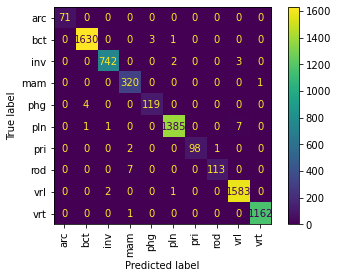

In [112]:
plot_confusion_matrix(best_model, t_cf_codons, train["Kingdom"])
plt.xticks(rotation='vertical')

### Test

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'arc'),
  Text(1, 0, 'bct'),
  Text(2, 0, 'inv'),
  Text(3, 0, 'mam'),
  Text(4, 0, 'phg'),
  Text(5, 0, 'pln'),
  Text(6, 0, 'pri'),
  Text(7, 0, 'rod'),
  Text(8, 0, 'vrl'),
  Text(9, 0, 'vrt')])

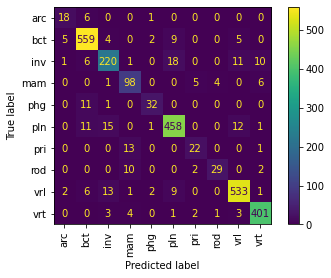

In [113]:
plot_confusion_matrix(best_model, test_codons, test["Kingdom"])
plt.xticks(rotation='vertical')

### Metrics

We show some metrics related to confusion matrix.

1. Sensitivity
2. Specificity
3. Precision
4. F-score is a measure of a test's accuracy. It is calculated from the precision and sensitivity of the test.

In [115]:
cm = confusion_matrix(test["Kingdom"], best_model.predict(test_codons))
cm.shape

(10, 10)

In [116]:
def sensitivity(cm):
    TP = cm[1,1]
    T = cm[1,:].sum()
    return TP / T

def specificity(cm):
    TN = cm[0,0]
    N = cm[0,:].sum()
    return TN / N

def precision(cm):
    TP = cm[1,1]
    TPFP = cm[:,1].sum()
    return TP / TPFP

def f1(cm):
    p = precision(cm)
    r = sensitivity(cm)
    return (2 * p * r) / (p + r)

print("Sensitivity ", sensitivity(cm))
print("Specificity ", specificity(cm))
print("Precision ", precision(cm))
print("F1-score", f1(cm))

Sensitivity  0.9571917808219178
Specificity  0.72
Precision  0.9332220367278798
F1-score 0.945054945054945


# REQUEST 3

# Regression

We want to recover the information of AGA and ACA codon frequencies. To do this we train different regression algorithms. Since the AGA and ACA features are missing in test samples, we use only the training data for this step. We have to divide the training dataset into train and test set.

In [16]:
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import mutual_info_regression
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.metrics import r2_score, mean_squared_error
import statsmodels.api as sm
from statsmodels.graphics.gofplots import qqplot
from sklearn.preprocessing import PolynomialFeatures
from sklearn.neighbors import KNeighborsRegressor
from sklearn.feature_selection import f_regression

We decided to work with a regressor that predicts both.

In [17]:
mpg_test_size = 0.2
mpg_test_seed = 20
# Split X and y into train and test
train_pd, test_pd = train_test_split(train_codons,
                                     test_size=mpg_test_size,
                                     random_state=mpg_test_seed)
X_train_split=train_pd.drop(["AGA","ACA"], axis=1)
X_test_split=test_pd.drop(["AGA","ACA"], axis=1)

In [18]:
y_train_split=train_pd[["AGA","ACA"]]
y_test_split=test_pd[["AGA","ACA"]]

The shape of y: [N_samples, 2]

In [19]:
y_train_split.shape

(5808, 2)

## Data visualization

First, we visualize how the missing codons are distributed in the different kingdoms. We see variability between the groups.

<AxesSubplot:xlabel='Kingdom', ylabel='AGA'>

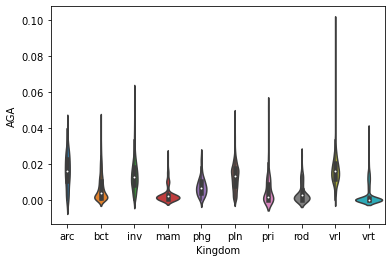

In [20]:
sns.violinplot(x="Kingdom", y="AGA", data=train)

In [21]:
np.mean(train["AGA"])

0.010027320936639165

<AxesSubplot:xlabel='Kingdom', ylabel='ACA'>

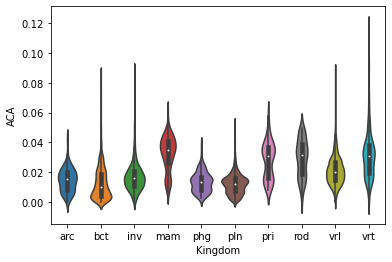

In [124]:
sns.violinplot(x="Kingdom", y="ACA", data=train)

In [22]:
np.mean(train["ACA"])

0.019138584022038586

# Linear regression

Linear Regression assumes that there is approximately a linear relationship between  𝑋  and  𝑌 , where  𝑋  is the set of features (or attributes) of each sample, and  𝑌  is the variable (or the variables) we want to predict.

$Y = {\beta}_{0} + {\beta}^{T}$

In [23]:
model = LinearRegression(fit_intercept=True)       
model.fit(X_train_split, y_train_split)                                    
y_predict_train = model.predict(X_train_split)
y_predict_test = model.predict(X_test_split)

In [24]:
print("Train R2 score ", r2_score(y_train_split, y_predict_train))
print("Train MSE score ", mean_squared_error(y_train_split, y_predict_train))

print("Test R2 score ", r2_score(y_test_split, y_predict_test))
print("Test MSE score ", mean_squared_error(y_test_split, y_predict_test))

Train R2 score  0.858631946642135
Train MSE score  1.4738417368705847e-05
Test R2 score  0.8618431379584849
Test MSE score  1.4079817548424541e-05


## Generalized linear model - Polynomial

Generalized linear models are linear in the coefficients but can be not linear in the original feature space. In this case we apply a polynomial transformation.

In [25]:
r2_scorer = make_scorer(r2_score,
                        greater_is_better=True)
mse_scorer = make_scorer(mean_squared_error,
                        greater_is_better=False)

In [26]:
model = Pipeline([('poly', PolynomialFeatures(degree=1, include_bias=False)),
                  ('linear', LinearRegression(fit_intercept=True))])

# Select parameters to optimize
parameters = {'poly__degree': list(range(2,4))}
              #'linear__fit_intercept': [True, False],
              #'linear__normalize': [True, False]}

cv = GridSearchCV(model, parameters, scoring=r2_scorer, cv=5, n_jobs=-1, verbose=False)
cv.fit(X_train_split, y_train_split)
print("Done!")

Done!


In [27]:
pd.DataFrame(cv.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_poly__degree,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,25.636997,0.820313,0.124889,0.039883,2,{'poly__degree': 2},0.673760,0.772148,0.633793,0.537273,0.833105,0.690016,0.103900,1
1,422.835247,14.356159,1.025734,0.448431,3,{'poly__degree': 3},0.371356,0.571381,-0.386693,-1.226289,0.621719,-0.009705,0.707639,2


In [28]:
# Retrieve the best **trained** estimator
print(cv.best_estimator_)
# Retrieve its parameters
print(cv.best_params_)
# Retrieve the best **CV** score
# I.e., mean of the scores on each fold
print(cv.best_score_)

Pipeline(steps=[('poly', PolynomialFeatures(include_bias=False)),
                ('linear', LinearRegression())])
{'poly__degree': 2}
0.6900157159690382


The $R^{2}$ does not improve with polynomial terms.

## Feature selection

We use feature selection on the linear regression model to see if the $R^{2}$ score improves. We will use the two types of regularization we already explained previously: Lasso and Ridge regression.

## Lasso

In [29]:
model = Pipeline([('scaler',preprocessing.StandardScaler()), 
               ('regressor',Lasso())])
alphas = np.linspace(1e-4, 0.5, 100)
params = {'regressor__alpha': alphas}
cv = GridSearchCV(model, params, refit="MSE", cv=5, 
                  scoring={"R^2": make_scorer(r2_score,greater_is_better=True),
                          "MSE": make_scorer(mean_squared_error,greater_is_better=False)})
cv.fit(X_train_split, y_train_split)
print("Done!")

Done!


In [30]:
pd.DataFrame(cv.cv_results_).sort_values(by="rank_test_MSE")[["param_regressor__alpha","mean_test_R^2","std_test_R^2","mean_test_MSE","std_test_MSE","rank_test_R^2","rank_test_MSE"]]

,param_regressor__alpha,mean_test_R^2,std_test_R^2,mean_test_MSE,std_test_MSE,rank_test_R^2,rank_test_MSE
0,0.0001,0.731249,0.009606,-0.000031,0.000002,1,1
1,0.005149,0.210086,0.006778,-0.000089,0.000006,2,2
72,0.363664,-0.002343,0.001332,-0.000122,0.000007,3,3
71,0.358614,-0.002343,0.001332,-0.000122,0.000007,3,3
70,0.353565,-0.002343,0.001332,-0.000122,0.000007,3,3
...,...,...,...,...,...,...,...
29,0.146535,-0.002343,0.001332,-0.000122,0.000007,3,3
28,0.141486,-0.002343,0.001332,-0.000122,0.000007,3,3
27,0.136436,-0.002343,0.001332,-0.000122,0.000007,3,3
25,0.126337,-0.002343,0.001332,-0.000122,0.000007,3,3


The best model has a score of 0.73

## Ridge

In [31]:
model = Pipeline([('scaler',preprocessing.StandardScaler()), 
               ('regressor',Ridge())])
alphas = np.linspace(1e-4, 0.5, 100)
params = {'regressor__alpha': alphas}
cv = GridSearchCV(model, params, refit="MSE", cv=5, 
                  scoring={"R^2": make_scorer(r2_score,greater_is_better=True),
                          "MSE": make_scorer(mean_squared_error,greater_is_better=False)})
cv.fit(X_train_split, y_train_split)
print("Done!")

Done!


In [32]:
pd.DataFrame(cv.cv_results_).sort_values(by="rank_test_MSE")[["param_regressor__alpha","mean_test_R^2","std_test_R^2","mean_test_MSE","std_test_MSE","rank_test_R^2","rank_test_MSE"]]

,param_regressor__alpha,mean_test_R^2,std_test_R^2,mean_test_MSE,std_test_MSE,rank_test_R^2,rank_test_MSE
6,0.030397,0.850955,0.009178,-0.000016,0.000002,30,1
7,0.035446,0.850955,0.009178,-0.000016,0.000002,28,2
5,0.025347,0.850955,0.009178,-0.000016,0.000002,32,3
8,0.040496,0.850955,0.009178,-0.000016,0.000002,26,4
4,0.020298,0.850955,0.009178,-0.000016,0.000002,34,5
...,...,...,...,...,...,...,...
95,0.479802,0.850938,0.009178,-0.000016,0.000002,96,96
96,0.484852,0.850938,0.009178,-0.000016,0.000002,97,97
97,0.489901,0.850937,0.009178,-0.000016,0.000002,98,98
98,0.494951,0.850937,0.009178,-0.000016,0.000002,99,99


The best model has a score of 0.851

## Conclusions

The best model is linear regression. We show the $R^{2}$ score and MSE for the split_train set and the split_test set.

In [33]:
final_model = LinearRegression(fit_intercept=True)       
final_model.fit(X_train_split, y_train_split)                                    
y_predict_train = final_model.predict(X_train_split)
y_predict_test = final_model.predict(X_test_split)

In [34]:
print("Train R2 score ", r2_score(y_train_split, y_predict_train))
print("Train MSE score ", mean_squared_error(y_train_split, y_predict_train))

print("Test R2 score ", r2_score(y_test_split, y_predict_test))
print("Test MSE score ", mean_squared_error(y_test_split, y_predict_test))

Train R2 score  0.858631946642135
Train MSE score  1.4738417368705847e-05
Test R2 score  0.8618431379584849
Test MSE score  1.4079817548424541e-05


# REQUEST 4

# Data recovery

Once that we have found the best model for regression, we can start the procedure of recovering.

In [35]:
test_predicted = final_model.predict(test_codons)

In [36]:
test_predicted

array([[ 0.00186523,  0.01524708],
       [ 0.00953709,  0.00963432],
       [ 0.00665398,  0.00899153],
       ...,
       [-0.00420802,  0.02264671],
       [ 0.02711684,  0.02729612],
       [-0.00154059,  0.02814926]])

The shape of the output [N_samples, 2].

In [37]:
test_predicted.shape

(2593, 2)

We create two lists with the frequencies for AGA and ACA.

In [38]:
AGA = [a[0] for a in test_predicted]
ACA = [b[1] for b in test_predicted]

In [41]:
test_codons["AGA"] = AGA
test_codons["ACA"] = ACA

Now we have all the 64 codons in the test set.

In [42]:
test_codons.shape

(2593, 64)

# Classification

We do classification using also AGA and ACA. We use SVM with RBF kernel, our best classifier. We test the performance on the test set.

In [43]:
svm_model = SVC(kernel='rbf', C=25.001, gamma=100)
svm_model.fit(train_codons, train["Kingdom"])

train_acc = accuracy_score(svm_model.predict(train_codons), train["Kingdom"])
test_acc = accuracy_score(svm_model.predict(test_codons), test["Kingdom"])

print("SVM train accuracy:", train_acc)
cv_svm = cross_val_score(svm_model, train_codons, train["Kingdom"], scoring=make_scorer(accuracy), cv=5,n_jobs=-1)
print("SVM CV score:", np.mean(cv_svm)) 
print("SVM test accuracy:", test_acc)

SVM train accuracy: 0.9982093663911846
SVM CV score: 0.9117079889807161
SVM test accuracy: 0.4866949479367528


The performance on the test set does not improve. The accuracy is very low for the test set. 